In [1]:
# Analyse des consommations électriques régionales en France de 2013 à 2022 sur la base des données de RTE stockées dans
# le fichier eco2mix-regional-cons-def.csv
# Exploration des données brutes du fichier (recherche des valeurs manquantes, colonnes utiles/inutiles, types des données, brèves statitistiques...
# Thierry ALLEM - Projet DataScientest - Formation Data Analyst -2024


In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import datetime
import matplotlib.pyplot as plt
%matplotlib inline


In [3]:
import warnings

# Pour ignorer tous les warnings
warnings.filterwarnings('ignore')


In [4]:
# Ajustement  de la largeur des colonnes des dataframes
pd.set_option('display.max_columns', None)  # afficher toutes les colonnes
pd.set_option('display.width', None)        # éviter le retour à la ligne auto
pd.set_option('display.colheader_justify', 'left')  # alignement des en-têtes

In [5]:
df_brut = pd.read_csv('eco2mix-regional-cons-def.csv',sep=';',na_values='ND',low_memory=False)

In [6]:
df_brut['Code INSEE région'].unique()

array([28, 84, 76, 93, 44, 27, 53, 11, 32, 24, 75, 52], dtype=int64)

In [7]:
df_brut.tail(20)

,Code INSEE région,Région,Nature,Date,Heure,Date - Heure,Consommation (MW),Thermique (MW),Nucléaire (MW),Eolien (MW),Solaire (MW),Hydraulique (MW),Pompage (MW),Bioénergies (MW),Ech. physiques (MW),Stockage batterie,Déstockage batterie,Eolien terrestre,Eolien offshore,TCO Thermique (%),TCH Thermique (%),TCO Nucléaire (%),TCH Nucléaire (%),TCO Eolien (%),TCH Eolien (%),TCO Solaire (%),TCH Solaire (%),TCO Hydraulique (%),TCH Hydraulique (%),TCO Bioénergies (%),TCH Bioénergies (%),Column 30
2121388,44,Grand Est,Données consolidées,2023-01-31,23:00,2023-01-31T23:00:00+01:00,6434.0,1444.0,5020.0,1881,0.0,629.0,-6.0,144.0,-2677.0,0.0,0.0,0.0,0.0,22.44,46.06,78.02,46.40,29.24,41.33,0.0,0.0,9.78,27.32,2.24,55.38,NaN
2121389,93,Provence-Alpes-Côte d'Azur,Données consolidées,2023-01-31,23:00,2023-01-31T23:00:00+01:00,6176.0,314.0,0.0,42,0.0,1882.0,0.0,85.0,3854.0,0.0,0.0,0.0,0.0,5.08,11.56,0.00,NaN,0.68,43.75,0.0,0.0,30.47,57.66,1.38,28.62,NaN
2121390,24,Centre-Val de Loire,Données consolidées,2023-01-31,23:00,2023-01-31T23:00:00+01:00,2522.0,111.0,8919.0,349,0.0,3.0,0.0,59.0,-6919.0,0.0,0.0,0.0,0.0,4.40,48.26,353.65,76.69,13.84,21.84,0.0,0.0,0.12,3.26,2.34,66.29,NaN
2121391,27,Bourgogne-Franche-Comté,Données consolidées,2023-01-31,23:00,2023-01-31T23:00:00+01:00,2768.0,167.0,0.0,211,0.0,222.0,0.0,49.0,2120.0,0.0,0.0,0.0,0.0,6.03,43.60,0.00,NaN,7.62,20.55,0.0,0.0,8.02,42.45,1.77,61.25,NaN
2121392,76,Occitanie,Données consolidées,2023-01-31,23:00,2023-01-31T23:00:00+01:00,5736.0,79.0,1234.0,786,0.0,1751.0,0.0,86.0,1800.0,0.0,0.0,0.0,0.0,1.38,27.24,21.51,47.10,13.70,47.93,0.0,0.0,30.53,33.07,1.50,50.29,NaN
2121393,52,Pays de la Loire,Données consolidées,2023-01-31,23:00,2023-01-31T23:00:00+01:00,3843.0,168.0,0.0,190,0.0,6.0,0.0,58.0,3421.0,0.0,0.0,0.0,0.0,4.37,8.35,0.00,NaN,4.94,11.01,0.0,0.0,0.16,60.00,1.51,70.73,NaN
2121394,28,Normandie,Données consolidées,2023-01-31,23:00,2023-01-31T23:00:00+01:00,3612.0,358.0,6277.0,305,0.0,16.0,0.0,88.0,-3433.0,0.0,0.0,0.0,0.0,9.91,45.43,173.78,58.99,8.44,31.12,0.0,0.0,0.44,55.17,2.44,66.17,NaN
2121395,32,Hauts-de-France,Données consolidées,2023-01-31,23:00,2023-01-31T23:00:00+01:00,5162.0,1335.0,4156.0,1896,0.0,2.0,0.0,129.0,-2355.0,0.0,0.0,0.0,0.0,25.86,54.83,80.51,76.12,36.73,33.24,0.0,0.0,0.04,50.00,2.50,62.02,NaN
2121396,11,Île-de-France,Données consolidées,2023-01-31,23:30,2023-01-31T23:30:00+01:00,9436.0,381.0,0.0,60,0.0,8.0,0.0,155.0,8835.0,0.0,0.0,0.0,0.0,4.04,17.53,0.00,NaN,0.64,41.38,0.0,0.0,0.08,42.11,1.64,48.59,NaN
2121397,28,Normandie,Données consolidées,2023-01-31,23:30,2023-01-31T23:30:00+01:00,3714.0,359.0,6279.0,328,0.0,16.0,0.0,88.0,-3356.0,0.0,0.0,0.0,0.0,9.67,45.56,169.06,59.01,8.83,33.47,0.0,0.0,0.43,55.17,2.37,66.17,NaN


In [8]:
# Affichage du nombre de lignes et colonnes du dataframe et décompte des types des valeurs

print("Nombre de lignes du dataframe : ", len(df_brut.index))
print("Nombre de colonnes du dataframe : ", len(df_brut.columns))
display("Types de valeurs :",df_brut.dtypes.value_counts() )
print("Nombre de doublons : ",df_brut.duplicated().sum())

Nombre de lignes du dataframe :  2121408
Nombre de colonnes du dataframe :  32


'Types de valeurs :'

float64    25
object      6
int64       1
Name: count, dtype: int64

Nombre de doublons :  0


In [9]:
df_brut.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2121408 entries, 0 to 2121407
Data columns (total 32 columns):
 #   Column               Dtype  
---  ------               -----  
 0   Code INSEE région    int64  
 1   Région               object 
 2   Nature               object 
 3   Date                 object 
 4   Heure                object 
 5   Date - Heure         object 
 6   Consommation (MW)    float64
 7   Thermique (MW)       float64
 8   Nucléaire (MW)       float64
 9   Eolien (MW)          object 
 10  Solaire (MW)         float64
 11  Hydraulique (MW)     float64
 12  Pompage (MW)         float64
 13  Bioénergies (MW)     float64
 14  Ech. physiques (MW)  float64
 15  Stockage batterie    float64
 16  Déstockage batterie  float64
 17  Eolien terrestre     float64
 18  Eolien offshore      float64
 19  TCO Thermique (%)    float64
 20  TCH Thermique (%)    float64
 21  TCO Nucléaire (%)    float64
 22  TCH Nucléaire (%)    float64
 23  TCO Eolien (%)       float64
 24

In [10]:
# Brèves statistiques de la colonne 'Consommation (MW)'
df_brut['Consommation (MW)'].describe()

count    2.121396e+06
mean     4.473428e+03
std      2.162117e+03
min      7.030000e+02
25%      2.768000e+03
50%      4.102000e+03
75%      5.708000e+03
max      1.533800e+04
Name: Consommation (MW), dtype: float64

In [11]:
# Création d'un dataframe de description des colonnes de df_brut, sans regroupement par région
df_colonnes = pd.DataFrame()

# Stockage des noms des colonnes du dataframe df_brut
df_colonnes['Nom_colonne'] = list(df_brut.columns)

# Attribution du type de valeurs des colonnes
df_colonnes['Type_valeurs'] = df_brut.dtypes.values

# Ajout d'une colonne 'Valeurs_uniques' par défaut à 'Valeurs continues'
df_colonnes['Valeurs_uniques'] = 'Valeurs continues'

# Spécificité pour certaines colonnes : affichage des valeurs uniques
df_colonnes.loc[df_colonnes['Nom_colonne'] == 'Code INSEE région', 'Valeurs_uniques'] = str(df_brut['Code INSEE région'].unique())
df_colonnes.loc[df_colonnes['Nom_colonne'] == 'Région', 'Valeurs_uniques'] = str(df_brut['Région'].unique())
df_colonnes.loc[df_colonnes['Nom_colonne'] == 'Nature', 'Valeurs_uniques'] = str(df_brut['Nature'].unique())

# Option d'affichage pour éviter la troncature des chaînes
pd.set_option('display.max_colwidth', None)

# Calcul du nombre de valeurs non nulles
df_colonnes['Nb_valeurs'] = df_brut.count().values

# Calcul du nombre de NaN
df_colonnes['nb_NaN'] = df_brut.isna().sum().values

# Total des données attendues
df_colonnes['Nb_datas'] = df_colonnes['Nb_valeurs'] + df_colonnes['nb_NaN']

# Pourcentage de données présentes et manquantes
df_colonnes['%_Valeurs'] = round((df_colonnes['Nb_valeurs'] / df_colonnes['Nb_datas']) * 100, 2)
df_colonnes['%_NaN'] = round((df_colonnes['nb_NaN'] / df_colonnes['Nb_datas']) * 100, 2)

# Identification des colonnes numériques uniquement (à partir de la 7ème colonne en général)
selected_columns = df_brut.columns[6:]
numeric_columns = [col for col in selected_columns if pd.api.types.is_numeric_dtype(df_brut[col])]

# Initialisation des colonnes pour le comptage
df_colonnes['Valeurs_POSITIVES'] = 0
df_colonnes['Valeurs_NULLES'] = 0
df_colonnes['Valeurs_NEGATIVES'] = 0

# Boucle pour calculer le nombre de valeurs positives, nulles et négatives uniquement sur les colonnes numériques
for col in numeric_columns:
    df_colonnes.loc[df_colonnes['Nom_colonne'] == col, 'Valeurs_POSITIVES'] = (df_brut[col] > 0).sum()
    df_colonnes.loc[df_colonnes['Nom_colonne'] == col, 'Valeurs_NULLES'] = (df_brut[col] == 0).sum()
    df_colonnes.loc[df_colonnes['Nom_colonne'] == col, 'Valeurs_NEGATIVES'] = (df_brut[col] < 0).sum()

# Calcul des pourcentages correspondants
df_colonnes['%_valeurs_POSITIVES'] = round((df_colonnes['Valeurs_POSITIVES'] / df_colonnes['Nb_valeurs']) * 100, 2)
df_colonnes['%_valeurs_NULLES'] = round((df_colonnes['Valeurs_NULLES'] / df_colonnes['Nb_valeurs']) * 100, 2)
df_colonnes['%_valeurs_NEGATIVES'] = round((df_colonnes['Valeurs_NEGATIVES'] / df_colonnes['Nb_valeurs']) * 100, 2)

# Vérification de la cohérence des taux (somme des pourcentages)
df_colonnes['Cumul_taux_valeurs'] = df_colonnes['%_valeurs_POSITIVES'] + df_colonnes['%_valeurs_NEGATIVES'] + df_colonnes['%_valeurs_NULLES']

# Désignation de la colonne 'Nom_colonne' comme index
df_colonnes.set_index('Nom_colonne', inplace=True)

# Export du compte-rendu dans un fichier Excel
file_export2 = 'Rapp_explo_col_eco2mix.xlsx'
df_colonnes.to_excel(file_export2)

# Message de confirmation
display("Rapport préliminaire d'exploration des colonnes du dataframe 'eco2mix-regional-cons-def' exporté avec succès dans le fichier Excel 'Rapp_explo_col_eco2mix.xlsx'")



"Rapport préliminaire d'exploration des colonnes du dataframe 'eco2mix-regional-cons-def' exporté avec succès dans le fichier Excel 'Rapp_explo_col_eco2mix.xlsx'"

In [12]:
df_colonnes.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32 entries, Code INSEE région to Column 30
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Type_valeurs         32 non-null     object 
 1   Valeurs_uniques      32 non-null     object 
 2   Nb_valeurs           32 non-null     int64  
 3   nb_NaN               32 non-null     int64  
 4   Nb_datas             32 non-null     int64  
 5   %_Valeurs            32 non-null     float64
 6   %_NaN                32 non-null     float64
 7   Valeurs_POSITIVES    32 non-null     int64  
 8   Valeurs_NULLES       32 non-null     int64  
 9   Valeurs_NEGATIVES    32 non-null     int64  
 10  %_valeurs_POSITIVES  31 non-null     float64
 11  %_valeurs_NULLES     31 non-null     float64
 12  %_valeurs_NEGATIVES  31 non-null     float64
 13  Cumul_taux_valeurs   31 non-null     float64
dtypes: float64(6), int64(6), object(2)
memory usage: 3.8+ KB


In [13]:
display(df_colonnes)

,Type_valeurs,Valeurs_uniques,Nb_valeurs,nb_NaN,Nb_datas,%_Valeurs,%_NaN,Valeurs_POSITIVES,Valeurs_NULLES,Valeurs_NEGATIVES,%_valeurs_POSITIVES,%_valeurs_NULLES,%_valeurs_NEGATIVES,Cumul_taux_valeurs
Nom_colonne,,,,,,,,,,,,,,
Code INSEE région,int64,[28 84 76 93 44 27 53 11 32 24 75 52],2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
Région,object,"['Normandie' 'Auvergne-Rhône-Alpes' 'Occitanie'\n ""Provence-Alpes-Côte d'Azur"" 'Grand Est' 'Bourgogne-Franche-Comté'\n 'Bretagne' 'Île-de-France' 'Hauts-de-France' 'Centre-Val de Loire'\n 'Nouvelle-Aquitaine' 'Pays de la Loire']",2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
Nature,object,['Données définitives' 'Données consolidées'],2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
Date,object,Valeurs continues,2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
Heure,object,Valeurs continues,2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
Date - Heure,object,Valeurs continues,2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
Consommation (MW),float64,Valeurs continues,2121396,12,2121408,100.00,0.00,2121396,0,0,100.00,0.00,0.00,100.00
Thermique (MW),float64,Valeurs continues,2121396,12,2121408,100.00,0.00,1877208,165861,78327,88.49,7.82,3.69,100.00
Nucléaire (MW),float64,Valeurs continues,1420121,701287,2121408,66.94,33.06,1235693,183984,444,87.01,12.96,0.03,100.00


In [14]:
df_colonnes = df_colonnes.reset_index()  # Réinitialisation de l'index

In [15]:
df_colonnes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32 entries, 0 to 31
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Nom_colonne          32 non-null     object 
 1   Type_valeurs         32 non-null     object 
 2   Valeurs_uniques      32 non-null     object 
 3   Nb_valeurs           32 non-null     int64  
 4   nb_NaN               32 non-null     int64  
 5   Nb_datas             32 non-null     int64  
 6   %_Valeurs            32 non-null     float64
 7   %_NaN                32 non-null     float64
 8   Valeurs_POSITIVES    32 non-null     int64  
 9   Valeurs_NULLES       32 non-null     int64  
 10  Valeurs_NEGATIVES    32 non-null     int64  
 11  %_valeurs_POSITIVES  31 non-null     float64
 12  %_valeurs_NULLES     31 non-null     float64
 13  %_valeurs_NEGATIVES  31 non-null     float64
 14  Cumul_taux_valeurs   31 non-null     float64
dtypes: float64(6), int64(6), object(3)
memory 

In [16]:
# Recherche de la date la plus ancienne des "Données définitives" et celle des "Données consolidées"  par région

df_donnees=df_brut.copy()

# Groupement par région et nature
grouped = df_donnees.groupby(['Région','Nature'])['Date - Heure']

# Obtention de la dernière ligne pour 'Données définitives' et la première ligne pour 'Données consolidées'
result = pd.concat([grouped.last(), grouped.first()])

# Enregistrement des résultats dans un fichier Excel
result.to_excel('resultats.xlsx', index=True)

print("Résultats enregistrés dans 'resultats.xlsx'")


Résultats enregistrés dans 'resultats.xlsx'


In [17]:
display(result)

Région                      Nature             
Auvergne-Rhône-Alpes        Données consolidées    2023-01-31T23:30:00+01:00
                            Données définitives    2022-12-31T23:30:00+01:00
Bourgogne-Franche-Comté     Données consolidées    2023-01-31T23:30:00+01:00
                            Données définitives    2022-12-31T23:30:00+01:00
Bretagne                    Données consolidées    2023-01-31T23:30:00+01:00
                            Données définitives    2022-12-31T23:30:00+01:00
Centre-Val de Loire         Données consolidées    2023-01-31T23:30:00+01:00
                            Données définitives    2022-12-31T23:30:00+01:00
Grand Est                   Données consolidées    2023-01-31T23:30:00+01:00
                            Données définitives    2022-12-31T23:30:00+01:00
Hauts-de-France             Données consolidées    2023-01-31T23:30:00+01:00
                            Données définitives    2022-12-31T23:30:00+01:00
Normandie                   

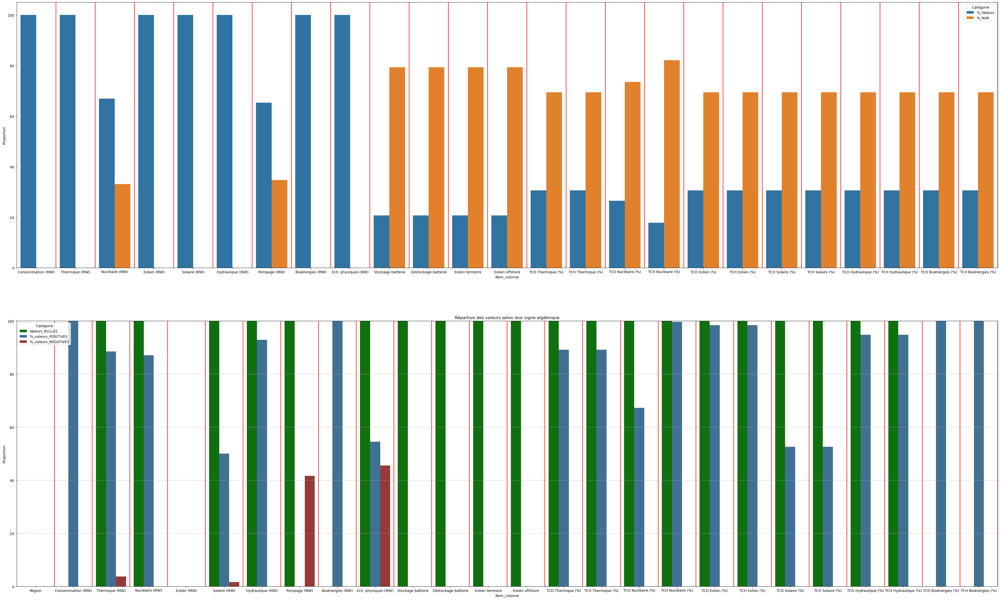

In [18]:
# Histogrammes  Valeurs/Nan et distribution des valeurs de df_brut, sans regroupement par région

# Suppression de colonnes  et de lignes de df_colonnes pour affichage d'histogrammes ultérieurs
# Liste des colonnes à supprimer
cols_to_drop = [1, 2, 3, 4, 5, 8, 9, 10, 11, 12, 13,14]

# Suppression des colonnes
df_hist_val_nan = df_colonnes.drop(df_colonnes.columns[cols_to_drop], axis=1)

# Réinitialisation de l'index
df_hist_val_nan = df_hist_val_nan.reset_index(drop=True)

# Liste des lignes à supprimer
rows_to_drop = [0,1, 2, 3, 4, 5,31]

# Suppression des lignes
df_hist_val_nan = df_hist_val_nan.drop(rows_to_drop, axis=0)

# Mise en forme longue du DataFrame
df_melt1 = df_hist_val_nan.melt(id_vars='Nom_colonne', var_name='Categorie', value_name='Proportion')

# Création d'une figure et d'un axe
fig, axs = plt.subplots(2,1, figsize=(50, 30))

# Création du diagramme à barres groupées
width = 0.35
histo_colonnes = sns.barplot(x='Nom_colonne', y='Proportion', hue='Categorie', data=df_melt1, ax=axs[0])
#histo_colonnes = sns.barplot(x='Nom_colonne', y='Value', hue='Category', data=df_melt1, ax=ax)

# Affichage d'une grille
plt.grid(linestyle = '-', axis = 'y')

# Récupération des positions x actuelles sur l'axe des abscisses

x_separation = histo_colonnes.get_xticks()

# Ajout d'une ligne verticale après chaque barre

for separation  in x_separation:
    histo_colonnes.axvline(separation + 0.5, color='red', linestyle='-')

# Affichage du titre
plt.title('Répartion des valeurs présentes et manquantes')

# Définition des limites de l'axe des y
plt.ylim(0, 100)

# Sauvegarde du graphique dans un fichier
histo_colonnes.figure.savefig('Histogramme_valeurs_nan.png')

# Histogramme des valeurs présentes- Répartitions

# Suppression de colonnes  et de lignes de df_colonnes pour affichage d'histogrammes ultérieurs
# Liste des colonnes à supprimer
cols_to_drop = [1, 2, 3, 4, 5, 6, 7, 8, 10, 12,14]

# Suppression des colonnes
df_hist_val = df_colonnes.drop(df_colonnes.columns[cols_to_drop], axis=1)

# Réinitialisation de l'index
df_hist_val = df_hist_val.reset_index(drop=True)

# Liste des lignes à supprimer
rows_to_drop = [0, 2, 3, 4, 5,31]

# Suppression des lignes
df_hist_val = df_hist_val.drop(rows_to_drop, axis=0)

# Mise en forme longue du DataFrame
df_melt2 = df_hist_val.melt(id_vars='Nom_colonne', var_name='Categorie', value_name='Proportion')

# Création du diagramme à barres groupées
width = 0.35
palette_colors = palette_colors = {
    'Valeurs_NULLES': 'green',        # Pour les valeurs nulles
    '%_valeurs_POSITIVES': '#3274a1',  # Pour les valeurs positives
    '%_valeurs_NEGATIVES': 'brown'     # Pour les valeurs négatives
}
histo_colonnes2 = sns.barplot(x='Nom_colonne', y='Proportion', hue='Categorie', palette =  palette_colors, data=df_melt2, ax=axs[1])
#histo_colonnes2 = sns.barplot(x='Nom_colonne', y='Pourcentage', hue='Distribution des valeurs', data=df_melt2, ax=axs[1])

# Affichage d'une grille
plt.grid(axis = 'y', linestyle = '--')

# Affichage du titre
plt.title('Répartion des valeurs selon leur signe algébrique')

# Définition des limites de l'axe des y
plt.ylim(0, 100)

# Récupération des positions x actuelles sur l'axe des abscisses

x_separation = histo_colonnes2.get_xticks()

# Ajout d'une ligne verticale après chaque barre

for separation  in x_separation:
    histo_colonnes2.axvline(separation + 0.5, color='red', linestyle='-')

# Affichage du graphique
plt.show()

# Sauvegarde du graphique dans un fichier
histo_colonnes2.figure.savefig('Repartition_valeurs_col.png')



In [19]:
# Affichage des colonnes
print(df_colonnes.iloc[:, 0].unique())

['Code INSEE région' 'Région' 'Nature' 'Date' 'Heure' 'Date - Heure'
 'Consommation (MW)' 'Thermique (MW)' 'Nucléaire (MW)' 'Eolien (MW)'
 'Solaire (MW)' 'Hydraulique (MW)' 'Pompage (MW)' 'Bioénergies (MW)'
 'Ech. physiques (MW)' 'Stockage batterie' 'Déstockage batterie'
 'Eolien terrestre' 'Eolien offshore' 'TCO Thermique (%)'
 'TCH Thermique (%)' 'TCO Nucléaire (%)' 'TCH Nucléaire (%)'
 'TCO Eolien (%)' 'TCH Eolien (%)' 'TCO Solaire (%)' 'TCH Solaire (%)'
 'TCO Hydraulique (%)' 'TCH Hydraulique (%)' 'TCO Bioénergies (%)'
 'TCH Bioénergies (%)' 'Column 30']


In [20]:
# Export du compte-rendu des colonnes dans un fichier Excel

file_export2 ='Rapp_explo_col_eco2mix.xlsx'

df_colonnes.to_excel(file_export2)

display("Rapport préliminaire d'exploration des colonnes du dataframe 'eco2mix-regional-cons-def' exporté avec succès dans le fichier Excel 'Rapp_explo_col_eco2mix.xlsx'")

"Rapport préliminaire d'exploration des colonnes du dataframe 'eco2mix-regional-cons-def' exporté avec succès dans le fichier Excel 'Rapp_explo_col_eco2mix.xlsx'"

In [21]:
display(df_colonnes)

,Nom_colonne,Type_valeurs,Valeurs_uniques,Nb_valeurs,nb_NaN,Nb_datas,%_Valeurs,%_NaN,Valeurs_POSITIVES,Valeurs_NULLES,Valeurs_NEGATIVES,%_valeurs_POSITIVES,%_valeurs_NULLES,%_valeurs_NEGATIVES,Cumul_taux_valeurs
0,Code INSEE région,int64,[28 84 76 93 44 27 53 11 32 24 75 52],2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
1,Région,object,"['Normandie' 'Auvergne-Rhône-Alpes' 'Occitanie'\n ""Provence-Alpes-Côte d'Azur"" 'Grand Est' 'Bourgogne-Franche-Comté'\n 'Bretagne' 'Île-de-France' 'Hauts-de-France' 'Centre-Val de Loire'\n 'Nouvelle-Aquitaine' 'Pays de la Loire']",2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
2,Nature,object,['Données définitives' 'Données consolidées'],2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
3,Date,object,Valeurs continues,2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
4,Heure,object,Valeurs continues,2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
5,Date - Heure,object,Valeurs continues,2121408,0,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00
6,Consommation (MW),float64,Valeurs continues,2121396,12,2121408,100.00,0.00,2121396,0,0,100.00,0.00,0.00,100.00
7,Thermique (MW),float64,Valeurs continues,2121396,12,2121408,100.00,0.00,1877208,165861,78327,88.49,7.82,3.69,100.00
8,Nucléaire (MW),float64,Valeurs continues,1420121,701287,2121408,66.94,33.06,1235693,183984,444,87.01,12.96,0.03,100.00
9,Eolien (MW),object,Valeurs continues,2121396,12,2121408,100.00,0.00,0,0,0,0.00,0.00,0.00,0.00


In [22]:
df_colonnes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32 entries, 0 to 31
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Nom_colonne          32 non-null     object 
 1   Type_valeurs         32 non-null     object 
 2   Valeurs_uniques      32 non-null     object 
 3   Nb_valeurs           32 non-null     int64  
 4   nb_NaN               32 non-null     int64  
 5   Nb_datas             32 non-null     int64  
 6   %_Valeurs            32 non-null     float64
 7   %_NaN                32 non-null     float64
 8   Valeurs_POSITIVES    32 non-null     int64  
 9   Valeurs_NULLES       32 non-null     int64  
 10  Valeurs_NEGATIVES    32 non-null     int64  
 11  %_valeurs_POSITIVES  31 non-null     float64
 12  %_valeurs_NULLES     31 non-null     float64
 13  %_valeurs_NEGATIVES  31 non-null     float64
 14  Cumul_taux_valeurs   31 non-null     float64
dtypes: float64(6), int64(6), object(3)
memory 

In [23]:
# Création d'une copie du dataframe d'origine avant modifications

df=df_brut.copy()
df.head()

,Code INSEE région,Région,Nature,Date,Heure,Date - Heure,Consommation (MW),Thermique (MW),Nucléaire (MW),Eolien (MW),Solaire (MW),Hydraulique (MW),Pompage (MW),Bioénergies (MW),Ech. physiques (MW),Stockage batterie,Déstockage batterie,Eolien terrestre,Eolien offshore,TCO Thermique (%),TCH Thermique (%),TCO Nucléaire (%),TCH Nucléaire (%),TCO Eolien (%),TCH Eolien (%),TCO Solaire (%),TCH Solaire (%),TCO Hydraulique (%),TCH Hydraulique (%),TCO Bioénergies (%),TCH Bioénergies (%),Column 30
0,28,Normandie,Données définitives,2013-01-01,00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,84,Auvergne-Rhône-Alpes,Données définitives,2013-01-01,00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,76,Occitanie,Données définitives,2013-01-01,00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,93,Provence-Alpes-Côte d'Azur,Données définitives,2013-01-01,00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,44,Grand Est,Données définitives,2013-01-01,00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2121408 entries, 0 to 2121407
Data columns (total 32 columns):
 #   Column               Dtype  
---  ------               -----  
 0   Code INSEE région    int64  
 1   Région               object 
 2   Nature               object 
 3   Date                 object 
 4   Heure                object 
 5   Date - Heure         object 
 6   Consommation (MW)    float64
 7   Thermique (MW)       float64
 8   Nucléaire (MW)       float64
 9   Eolien (MW)          object 
 10  Solaire (MW)         float64
 11  Hydraulique (MW)     float64
 12  Pompage (MW)         float64
 13  Bioénergies (MW)     float64
 14  Ech. physiques (MW)  float64
 15  Stockage batterie    float64
 16  Déstockage batterie  float64
 17  Eolien terrestre     float64
 18  Eolien offshore      float64
 19  TCO Thermique (%)    float64
 20  TCH Thermique (%)    float64
 21  TCO Nucléaire (%)    float64
 22  TCH Nucléaire (%)    float64
 23  TCO Eolien (%)       float64
 24

In [25]:
# Création d'une nouvelle colonne de dates avec le format '%Y-%m-%d %H:%M'
df.insert(5, 'date_heure_cet', (df['Date'].astype(str) + ' ' + df['Heure'].astype(str)))


In [26]:
df.head()

,Code INSEE région,Région,Nature,Date,Heure,date_heure_cet,Date - Heure,Consommation (MW),Thermique (MW),Nucléaire (MW),Eolien (MW),Solaire (MW),Hydraulique (MW),Pompage (MW),Bioénergies (MW),Ech. physiques (MW),Stockage batterie,Déstockage batterie,Eolien terrestre,Eolien offshore,TCO Thermique (%),TCH Thermique (%),TCO Nucléaire (%),TCH Nucléaire (%),TCO Eolien (%),TCH Eolien (%),TCO Solaire (%),TCH Solaire (%),TCO Hydraulique (%),TCH Hydraulique (%),TCO Bioénergies (%),TCH Bioénergies (%),Column 30
0,28,Normandie,Données définitives,2013-01-01,00:00,2013-01-01 00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,84,Auvergne-Rhône-Alpes,Données définitives,2013-01-01,00:00,2013-01-01 00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,76,Occitanie,Données définitives,2013-01-01,00:00,2013-01-01 00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,93,Provence-Alpes-Côte d'Azur,Données définitives,2013-01-01,00:00,2013-01-01 00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,44,Grand Est,Données définitives,2013-01-01,00:00,2013-01-01 00:00,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [27]:
# Conversion des colonnes 'date','Heure' et 'date_heure_cet' au format datetime
df['Date'] = pd.to_datetime(df['Date'], format = '%Y-%m-%d', yearfirst = True, exact = True)
df['Heure'] = pd.to_datetime(df['Heure'], format = '%H:%M')
df['date_heure_cet'] = pd.to_datetime(df['date_heure_cet'], format='%Y-%m-%d %H:%M',  errors='coerce')
df.dtypes

Code INSEE région               int64
Région                         object
Nature                         object
Date                   datetime64[ns]
Heure                  datetime64[ns]
date_heure_cet         datetime64[ns]
Date - Heure                   object
Consommation (MW)             float64
Thermique (MW)                float64
Nucléaire (MW)                float64
Eolien (MW)                    object
Solaire (MW)                  float64
Hydraulique (MW)              float64
Pompage (MW)                  float64
Bioénergies (MW)              float64
Ech. physiques (MW)           float64
Stockage batterie             float64
Déstockage batterie           float64
Eolien terrestre              float64
Eolien offshore               float64
TCO Thermique (%)             float64
TCH Thermique (%)             float64
TCO Nucléaire (%)             float64
TCH Nucléaire (%)             float64
TCO Eolien (%)                float64
TCH Eolien (%)                float64
TCO Solaire 

In [28]:
# Ajout d'une colonne 'Mois' et d'une colonne 'Année' extraites de la colonne 'Date'
df.insert(4, 'Mois', df['Date'].dt.month)

df.insert(5, 'Année', df['Date'].dt.year)

# Création d'une colonne date au format YYYY-MM, type Object

df.insert(6, 'Date YM', df['Date'].dt.strftime('%Y-%m'))


In [29]:
df.head()

,Code INSEE région,Région,Nature,Date,Mois,Année,Date YM,Heure,date_heure_cet,Date - Heure,Consommation (MW),Thermique (MW),Nucléaire (MW),Eolien (MW),Solaire (MW),Hydraulique (MW),Pompage (MW),Bioénergies (MW),Ech. physiques (MW),Stockage batterie,Déstockage batterie,Eolien terrestre,Eolien offshore,TCO Thermique (%),TCH Thermique (%),TCO Nucléaire (%),TCH Nucléaire (%),TCO Eolien (%),TCH Eolien (%),TCO Solaire (%),TCH Solaire (%),TCO Hydraulique (%),TCH Hydraulique (%),TCO Bioénergies (%),TCH Bioénergies (%),Column 30
0,28,Normandie,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,84,Auvergne-Rhône-Alpes,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,76,Occitanie,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,93,Provence-Alpes-Côte d'Azur,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,44,Grand Est,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [30]:
# Suppression de la colonne 'Column 30'

df.drop(columns=['Column 30'], inplace=True)

In [31]:
# Export du dataframe dans un fichier csv

eco2mix_temporaire = df.copy()
file_export_csv ='eco2mix_temporaire.csv'

eco2mix_temporaire.to_csv(file_export_csv,sep=';',encoding='latin-1')


In [32]:
# Calcul des statistiques descriptives pour la colonne 'Consommation (MW)'
stats = df['Consommation (MW)'].describe()

# Conversion des statistiques en DataFrame et transposition des résultats
stats_df = stats.to_frame().T

display(stats_df)

,count,mean,std,min,25%,50%,75%,max
Consommation (MW),2121396.0,4473.428121,2162.117017,703.0,2768.0,4102.0,5708.0,15338.0


In [33]:
# Filtrage des années entre 2013 et 2022
df_filtered = df[(df['Année'] >= 2013) & (df['Année'] <= 2021)]

# Groupement par région et application de describe()
result = df_filtered.groupby('Région')['Consommation (MW)'].describe()

# Calcul des statistiques descriptives pour l'ensemble des régions et années de 2013 à 2021
#stats = df['Consommation (MW)'].describe()
# Conversion des statistiques en DataFrame et transposition des résultats
# national_stats = stats.to_frame().T

# Créeation d'une nouvelle ligne dans le tableau incluant les statitistiques nationales de 2013 à 2021
# df_result = pd.concat([national_stats, result], axis =1)

display(result)

,count,mean,std,min,25%,50%,75%,max
Région,,,,,,,,
Auvergne-Rhône-Alpes,157775.0,7512.697753,1573.314869,4101.0,6253.0,7361.0,8603.0,13177.0
Bourgogne-Franche-Comté,157775.0,2434.680596,557.904252,895.0,1996.0,2399.0,2807.0,4356.0
Bretagne,157775.0,2543.820624,663.450611,1103.0,2049.0,2451.0,3016.0,5363.0
Centre-Val de Loire,157775.0,2140.340555,551.990006,1000.0,1719.0,2030.0,2532.0,4156.0
Grand Est,157775.0,5201.456486,1045.878368,2502.0,4387.0,5129.0,5906.0,8568.0
Hauts-de-France,157775.0,5769.233643,1108.582834,3292.0,4916.0,5635.0,6544.0,9598.0
Normandie,157775.0,3189.616295,726.250211,1675.0,2633.0,3058.0,3720.0,5759.0
Nouvelle-Aquitaine,157775.0,4952.291301,1143.357474,2539.0,4094.0,4760.0,5715.0,9663.0
Occitanie,157775.0,4270.609336,1033.596749,2167.0,3522.0,4081.0,4929.0,8699.0


In [34]:
# 1.2 : Gestion des noms et types de S NOMS ET TYPES DE VARIABLES

# on fait un premier dictionnaire pour changer les en-têtes du df_2 dans la même version que le df_1
dictionnaire_entetes1 = {'Code INSEE région' : 'code_insee_region',
                'Région' : 'region',
                'Nature' : 'nature',
                'Date' : 'date',
                'Heure' : 'heure',
                'Date - Heure' : 'date_heure',
                'Mois' : 'mois',
                'Année' :'annee',
                'Date YM' : 'date_ym',
                'Consommation (MW)' : 'consommation',
                'Thermique (MW)' : 'thermique',
                'Nucléaire (MW)' : 'nucleaire',
                'Eolien (MW)' : 'eolien',
                'Solaire (MW)' : 'solaire',
                'Hydraulique (MW)' : 'hydraulique',
                'Pompage (MW)' : 'pompage',
                'Bioénergies (MW)' : 'bioenergies',
                'Ech. physiques (MW)' : 'ech_physiques',
                'Stockage batterie' : 'stockage_batterie',
                'Déstockage batterie' : 'destockage_batterie',
                'TCO Thermique (%)' : 'tco_thermique',
                'TCH Thermique (%)' : 'tch_thermique',
                'TCO Nucléaire (%)' : 'tco_nucleaire',
                'TCH Nucléaire (%)' : 'tch_nucleaire',
                'TCO Eolien (%)' : 'tco_eolien',
                'TCH Eolien (%)' : 'tch_eolien',
                'TCO Solaire (%)' : 'tco_solaire',
                'TCH Solaire (%)' : 'tch_solaire',
                'TCO Hydraulique (%)' : 'tco_hydraulique',
                'TCH Hydraulique (%)' : 'tch_hydraulique',
                'TCO Bioénergies (%)' : 'tco_bioenergies',
                'TCH Bioénergies (%)' : 'tch_bioenergies'}
df=df.rename(dictionnaire_entetes1, axis = 1)

In [35]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2121408 entries, 0 to 2121407
Data columns (total 35 columns):
 #   Column               Dtype         
---  ------               -----         
 0   code_insee_region    int64         
 1   region               object        
 2   nature               object        
 3   date                 datetime64[ns]
 4   mois                 int32         
 5   annee                int32         
 6   date_ym              object        
 7   heure                datetime64[ns]
 8   date_heure_cet       datetime64[ns]
 9   date_heure           object        
 10  consommation         float64       
 11  thermique            float64       
 12  nucleaire            float64       
 13  eolien               object        
 14  solaire              float64       
 15  hydraulique          float64       
 16  pompage              float64       
 17  bioenergies          float64       
 18  ech_physiques        float64       
 19  stockage_batterie    

In [36]:
df.head()

,code_insee_region,region,nature,date,mois,annee,date_ym,heure,date_heure_cet,date_heure,consommation,thermique,nucleaire,eolien,solaire,hydraulique,pompage,bioenergies,ech_physiques,stockage_batterie,destockage_batterie,Eolien terrestre,Eolien offshore,tco_thermique,tch_thermique,tco_nucleaire,tch_nucleaire,tco_eolien,tch_eolien,tco_solaire,tch_solaire,tco_hydraulique,tch_hydraulique,tco_bioenergies,tch_bioenergies
0,28,Normandie,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,84,Auvergne-Rhône-Alpes,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,76,Occitanie,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,93,Provence-Alpes-Côte d'Azur,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,44,Grand Est,Données définitives,2013-01-01,1,2013,2013-01,1900-01-01,2013-01-01,2013-01-01T00:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


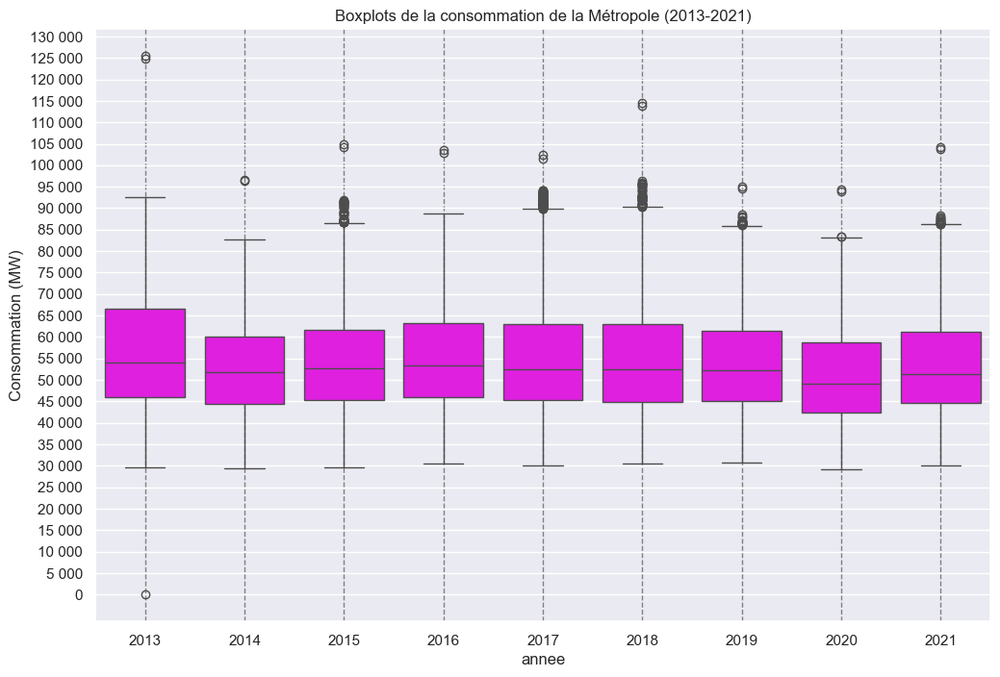

In [37]:
#Création de boxplot de la colonne "Consommation" à l'échelle métropolitaine et par année de 2013 à 2021 (années complètes)
from matplotlib.ticker import FuncFormatter

# Fonction pour formater les étiquettes des ordonnées avec des séparateurs de milliers
def thousands_formatter(x, pos):
    return f'{int(x):,}'.replace(',', ' ')
    
# Filtrage des données pour les années 2013 à 2021
df_metropole = df[(df['annee'] >= 2013) & (df['annee'] <= 2021)]

# Regroupement par 'date_heure' pour obtenir la consommation totale de toutes les régions à chaque instant
df_metropole_grouped = df_metropole.groupby(['date_heure', 'annee'], as_index=False)['consommation'].sum()

# Configuration du style de seaborn
sns.set_theme(palette="bright")

# Création de la figure pour le boxplot
plt.figure(figsize=(12, 8))

# Création du boxplot
sns.boxplot(x='annee', y='consommation', data=df_metropole_grouped, color='fuchsia')

# Ajout de la grille verticale
plt.grid(axis='x', linestyle='--', color='gray')

# Graduation de l'axe des ordonnées tous les 5000 MW
plt.yticks(range(0, int(df_metropole_grouped['consommation'].max()) + 5000, 5000))
# Formater les étiquettes des ordonnées avec des séparateurs de milliers
plt.gca().yaxis.set_major_formatter(FuncFormatter(thousands_formatter))

plt.ylabel('Année')
plt.ylabel('Consommation (MW)')

# Définition du titre du graphique
plt.title('Boxplots de la consommation de la Métropole (2013-2021)')

# Sauvegarde du graphique dans un fichier image
plt.savefig('metropole_boxplot.png',dpi =300)

# Affichage du graphique
plt.show()



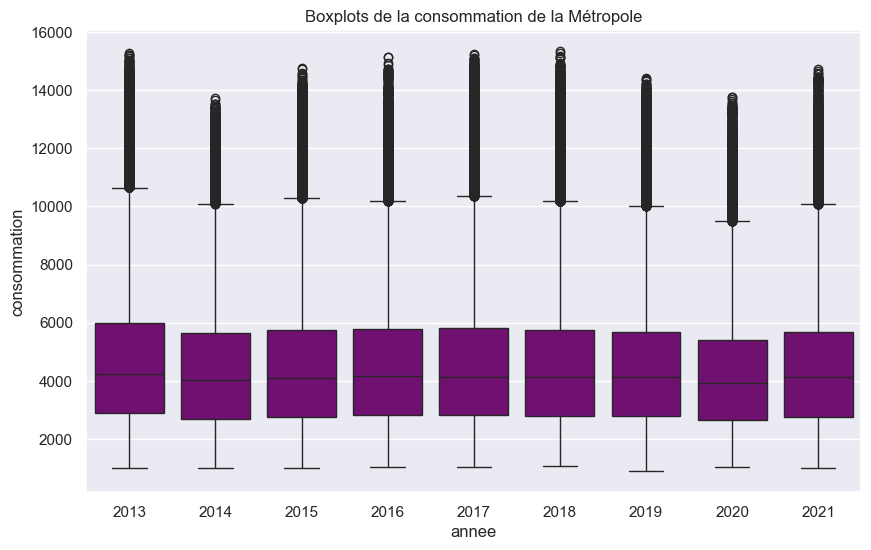

In [38]:
#Création de boxplot de la colonne "Consommation" à l'échelle métropolitaine et par année de 2013 à 2021 (années complètes)

# Liste des régions

sns.set_theme(palette="bright")

df_metropole = df[(df['annee'] >= 2013) & (df['annee'] <= 2021)]
    
plt.figure(figsize=(10, 6))

# Création du boxplot
sns.boxplot(x='annee', y='consommation', data=df_metropole, color = 'purple')

# Bornage de l'axe des abscisses
#plt.ylim(0, 16000)
      
 # Définition du titre du graphique
plt.title('Boxplots de la consommation de la Métropole')

    # Sauvegarde du graphique dans un fichier image
plt.savefig('metropole' + '_boxplot.png')

plt.show()

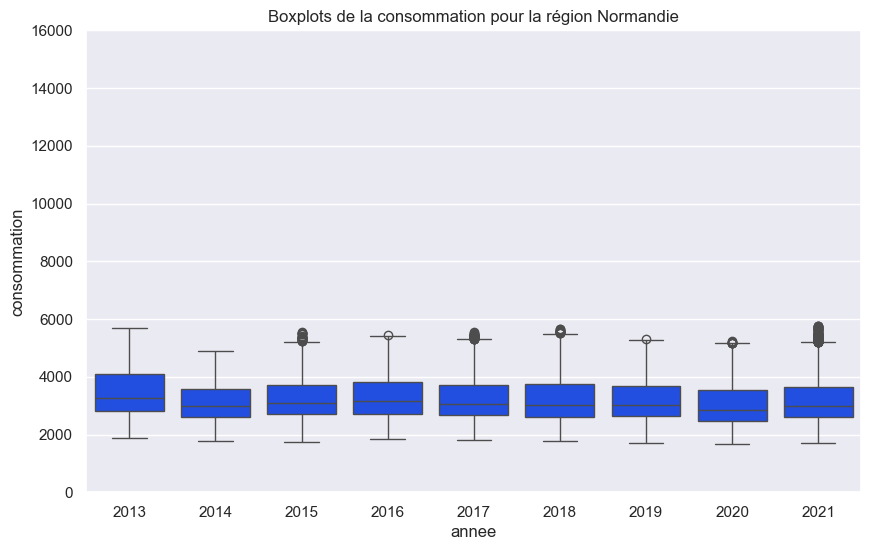

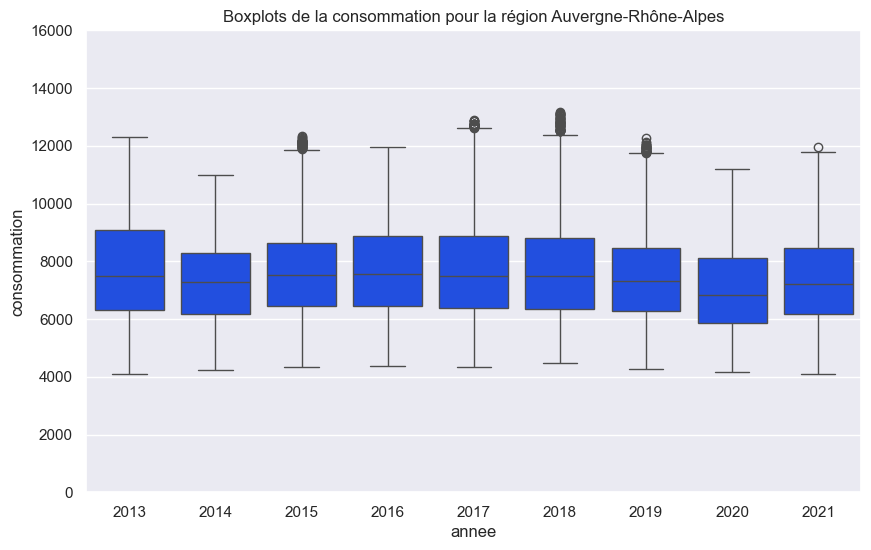

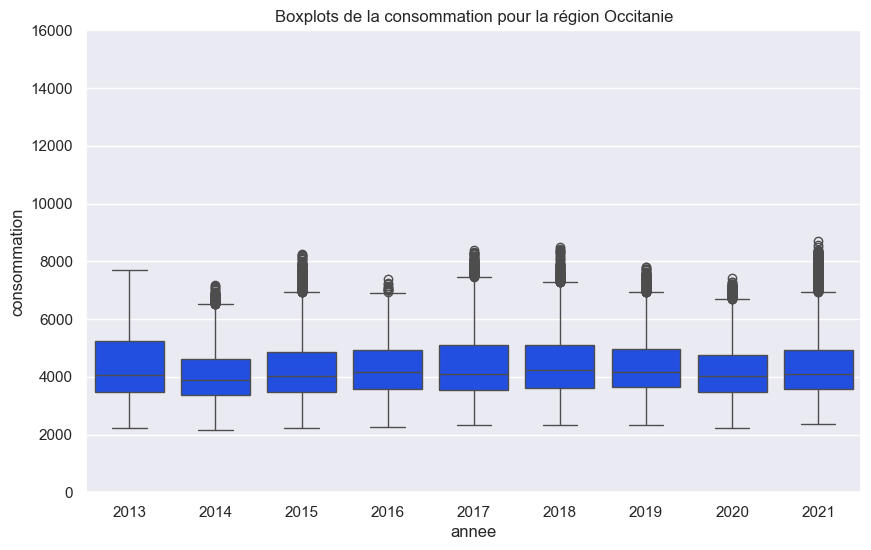

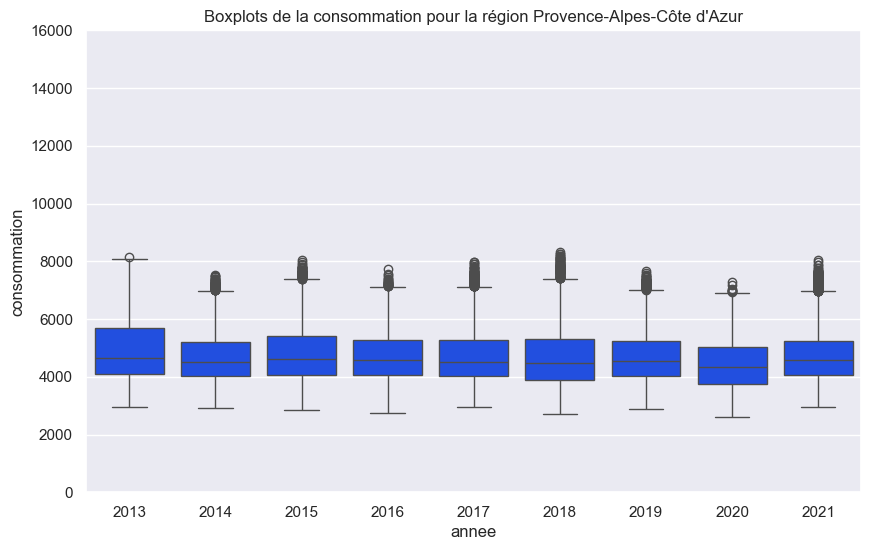

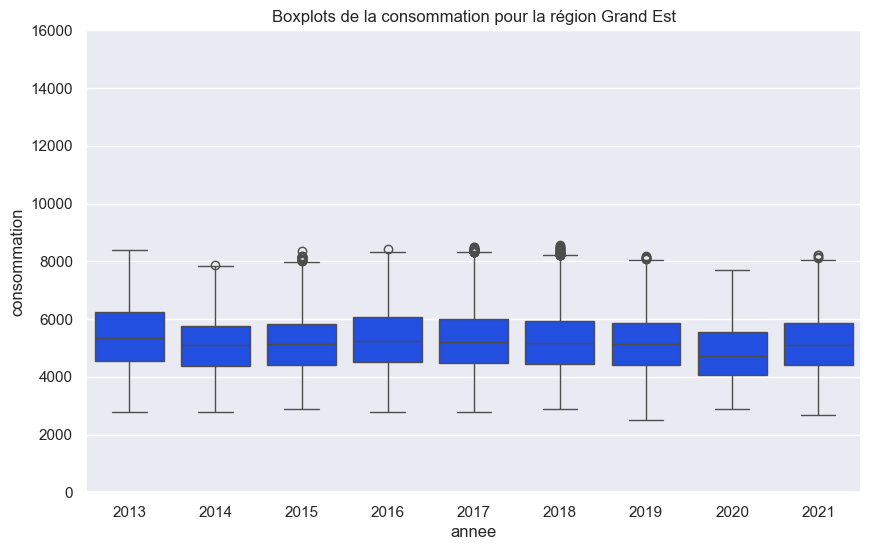

...

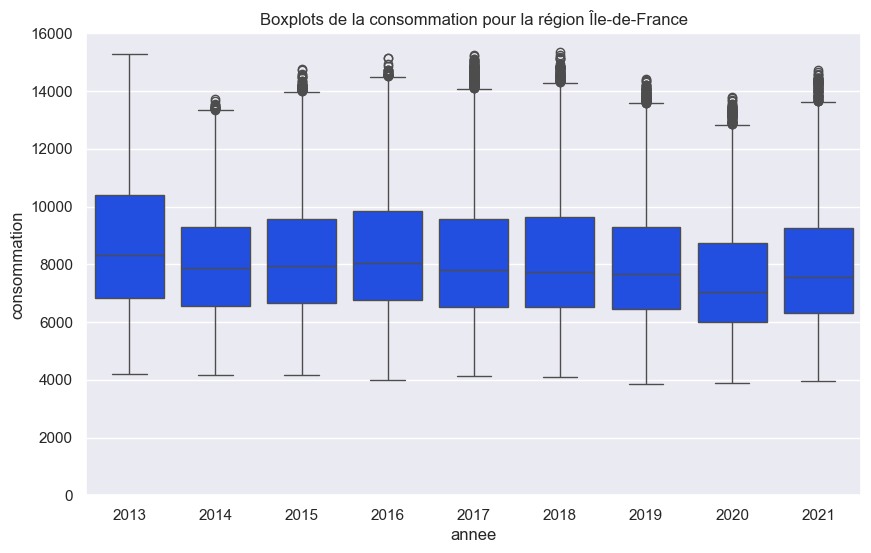

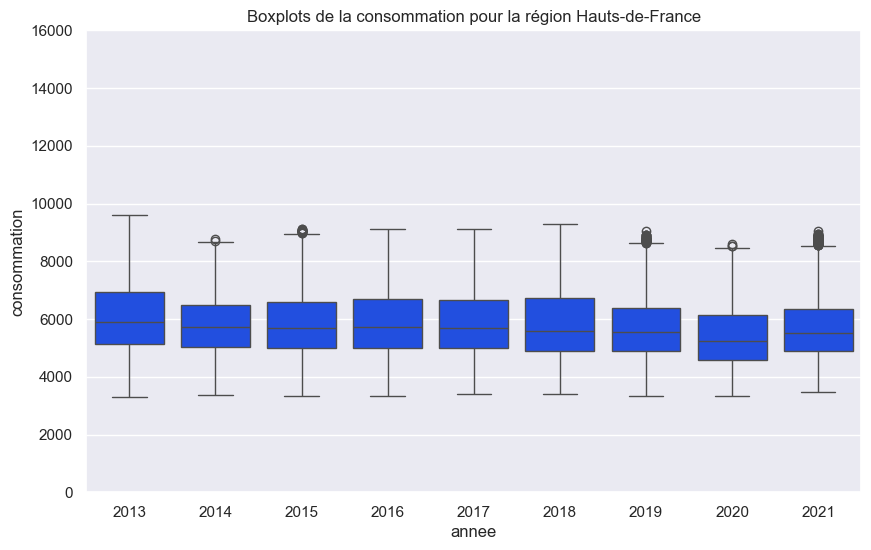

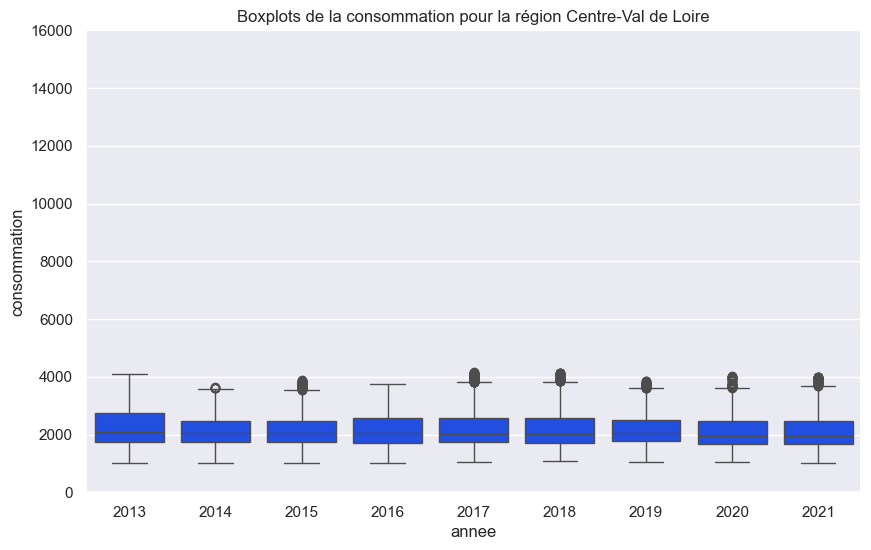

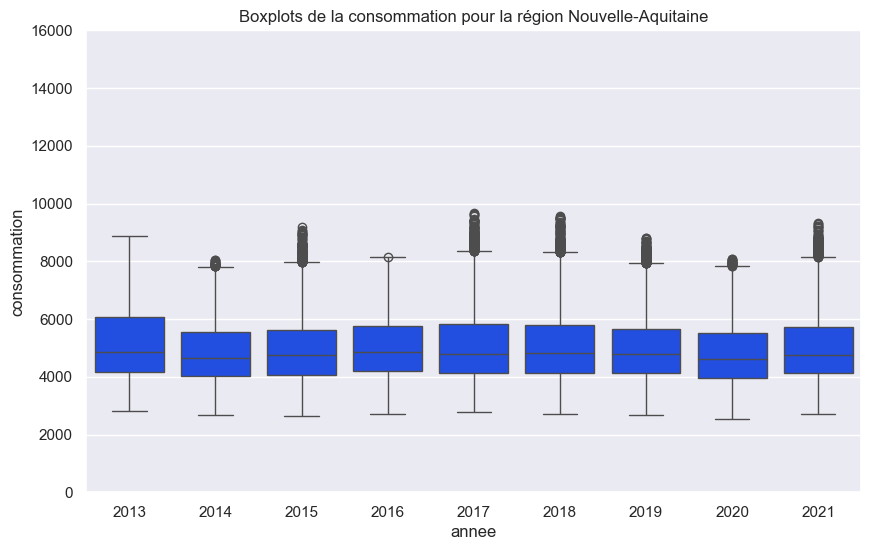

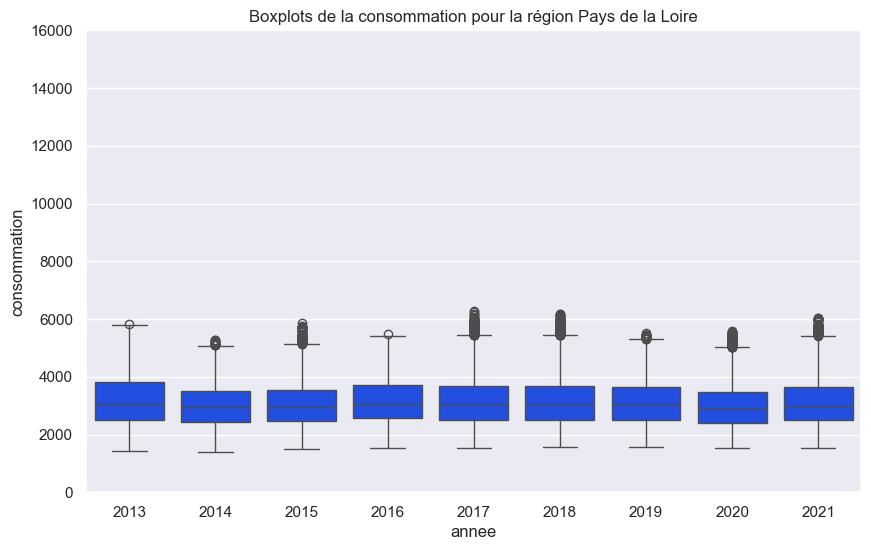

In [39]:
#Création de boxplot de la colonne "Consommation" par région et par année de 2013 à 2021 (années complètes)

# Liste des régions
regions = df['region'].unique()
sns.set_theme(palette="bright")

for region in regions:
    # Création d'un sous-dataframe pour chaque région
    df_region = df[(df['region'] == region) & (df['annee'] >= 2013) & (df['annee'] <= 2021)]
    
    # Création d'une figure pour chaque région
    plt.figure(figsize=(10, 6))

    # Création du boxplot
    sns.boxplot(x='annee', y='consommation', data=df_region)

    # Uniformisation de l'axe des abscisses
    plt.ylim(0, 16000)
      
    # Définition du titre du graphique
    plt.title('Boxplots de la consommation pour la région ' + region)

    # Sauvegarde du graphique dans un fichier image
    plt.savefig(region + '_boxplot.png')

plt.show()


In [40]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2121408 entries, 0 to 2121407
Data columns (total 35 columns):
 #   Column               Dtype         
---  ------               -----         
 0   code_insee_region    int64         
 1   region               object        
 2   nature               object        
 3   date                 datetime64[ns]
 4   mois                 int32         
 5   annee                int32         
 6   date_ym              object        
 7   heure                datetime64[ns]
 8   date_heure_cet       datetime64[ns]
 9   date_heure           object        
 10  consommation         float64       
 11  thermique            float64       
 12  nucleaire            float64       
 13  eolien               object        
 14  solaire              float64       
 15  hydraulique          float64       
 16  pompage              float64       
 17  bioenergies          float64       
 18  ech_physiques        float64       
 19  stockage_batterie    

{'date_heure': ('pivot_date_heur',
  'date_heurval_map',
  '7_date_heur_val_heatmap.png'),
 'consommation': ('pivot_consommat',
  'consommatval_map',
  '8_consommat_val_heatmap.png'),
 'thermique': ('pivot_thermique',
  'thermiqueval_map',
  '9_thermique_val_heatmap.png'),
 'nucleaire': ('pivot_nucleaire',
  'nucleaireval_map',
  '10_nucleaire_val_heatmap.png'),
 'eolien': ('pivot_eolien', 'eolienval_map', '11_eolien_val_heatmap.png'),
 'solaire': ('pivot_solaire', 'solaireval_map', '12_solaire_val_heatmap.png'),
 'hydraulique': ('pivot_hydrauliq',
  'hydrauliqval_map',
  '13_hydrauliq_val_heatmap.png'),
 'pompage': ('pivot_pompage', 'pompageval_map', '14_pompage_val_heatmap.png'),
 'bioenergies': ('pivot_bioenergi',
  'bioenergival_map',
  '15_bioenergi_val_heatmap.png'),
 'ech_physiques': ('pivot_ech_physi',
  'ech_physival_map',
  '16_ech_physi_val_heatmap.png'),
 'stockage_batterie': ('pivot_stockage_',
  'stockage_val_map',
  '17_stockage__val_heatmap.png'),
 'destockage_batterie'

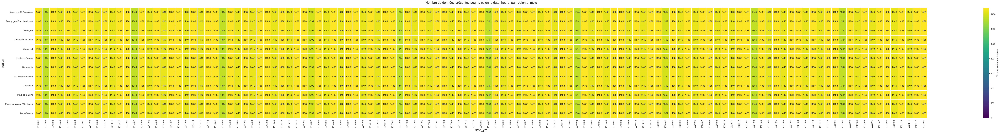

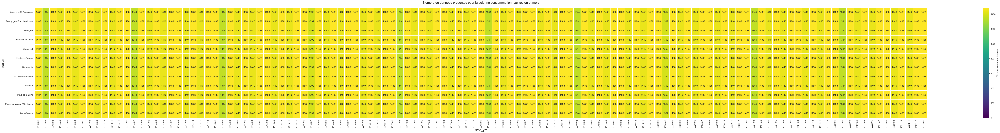

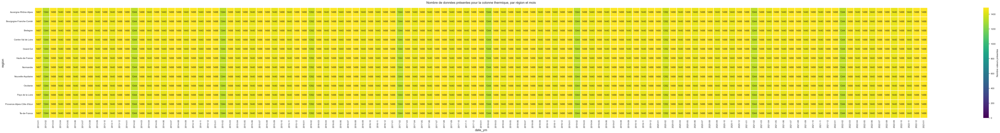

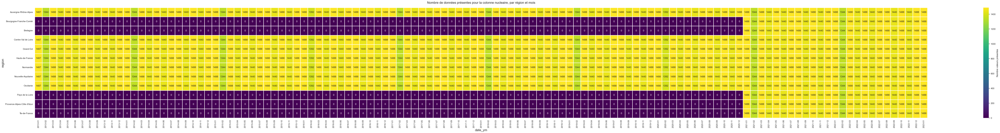

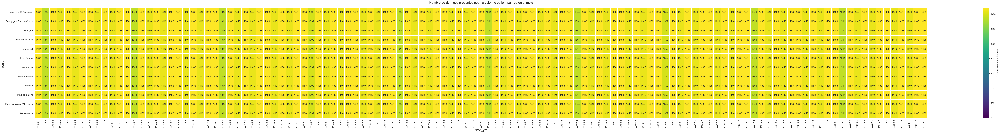

...

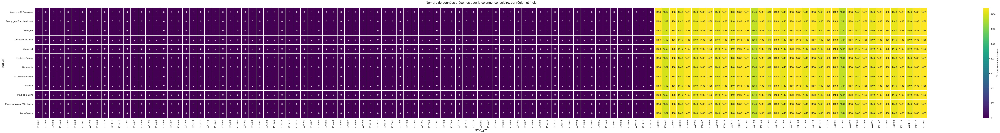

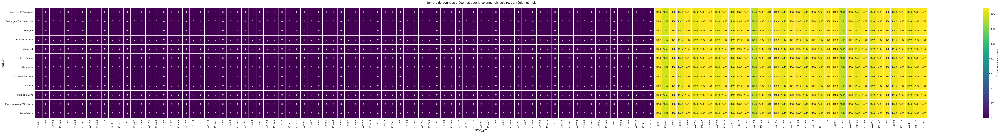

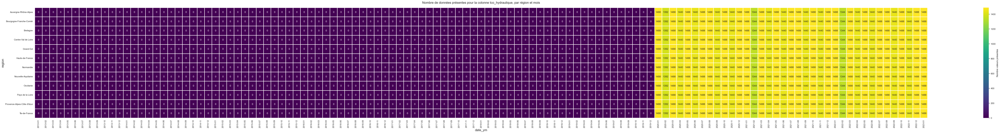

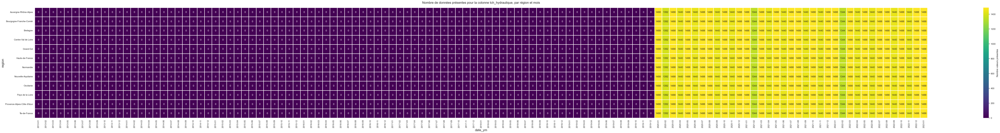

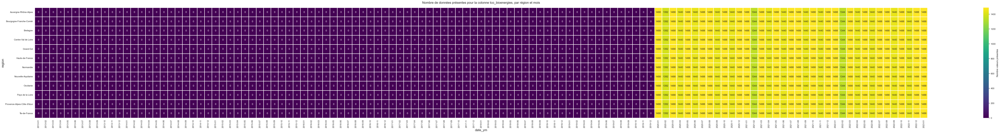

Rapport préliminaire de décompte des valeurs après regroupements exporté avec succès dans le fichier Excel 'Rapp_count_val_eco2mix.xlsx'


In [41]:
# ****** ETUDE DES VALEURS PRESENTES ******

# Calcul du nombre de valeurs présentes pour chaque colonne, par région et par mois.

count_val = df.groupby([df['region'], df['date_ym']],as_index=False).count()

# Suppression des colonnes  de count_val

count_val.drop(columns = count_val.columns[2:9], inplace=True)

# AFFICHAGE DES HEATMAPS DES VALEURS PRESENTES, REGROUPEES PAR REGION ET PAR MOIS

# 1) Création d'un dictionnaire associant les colonnes mappées avec les noms des graphiques et des fichiers images à créer

dict_heatmaps_energie = {}
colonnes=['7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','23','24','25','26','27','28','29','30','31']
c= 0
for i in range(2, 27):
    nom_colonne = count_val.columns[i]
    pivot = 'pivot_'+ nom_colonne[:9]
    nom_heatmap = nom_colonne[:9].replace(' ', '_') + 'val_map'
    nom_fichier = colonnes[c]+'_'+ nom_colonne[:9].replace(' ', '_') + '_val_heatmap.png'
    dict_heatmaps_energie[nom_colonne] = (pivot, nom_heatmap, nom_fichier)
    c+=1

display(dict_heatmaps_energie)

# 2) Affichage des chronogramme des valeurs présentes pour chaque colonne de données d'énergie

for i in range(2,27):
    
    nom_colonne = count_val.columns[i]
    pivot, nom_heatmap, nom_fichier = dict_heatmaps_energie[nom_colonne]
                                                       
    # Pivot du DataFrame pour obtenir les dates comme colonnes
 
    pivot_df = count_val.pivot(index='region', columns='date_ym', values=nom_colonne)

    # Remplissage des valeurs manquantes avec 0
    pivot_df.fillna(0, inplace=True)

    # Création d'un heatmap
    plt.figure(figsize=(100, 10))
    nom_heatmap = sns.heatmap(pivot_df, cmap='viridis', annot=True, fmt='d', cbar_kws={'label': 'Nombre valeurs présentes'},
                                 linewidths = 1, vmin = 0, vmax = 1488)
    plt.title(f"Nombre de données présentes pour la colonne {nom_colonne}, par région et mois", fontsize = 16, pad = 20)
    plt.xlabel('date_ym', fontsize = 16)
    plt.ylabel('region', fontsize = 16)
    plt.show()

    nom_heatmap.figure.savefig(nom_fichier)


# Export Excel du compte-rendu du nb de valeurs présentes par colonne après regroupement region/jour-mois

file_export_count_val ='Rapp_count_val_eco2mix.xlsx'

count_val.to_excel(file_export_count_val)

print("Rapport préliminaire de décompte des valeurs après regroupements exporté avec succès dans le fichier Excel 'Rapp_count_val_eco2mix.xlsx'")



In [42]:
count_val.tail(30)

,region,date_ym,date_heure,consommation,thermique,nucleaire,eolien,solaire,hydraulique,pompage,bioenergies,ech_physiques,stockage_batterie,destockage_batterie,Eolien terrestre,Eolien offshore,tco_thermique,tch_thermique,tco_nucleaire,tch_nucleaire,tco_eolien,tch_eolien,tco_solaire,tch_solaire,tco_hydraulique,tch_hydraulique,tco_bioenergies,tch_bioenergies
1422,Île-de-France,2020-08,1488,1488,1488,0,1488,1488,1488,0,1488,1488,0,0,0,0,1488,1488,0,0,1488,1488,1488,1488,1488,1488,1488,1488
1423,Île-de-France,2020-09,1440,1440,1440,0,1440,1440,1440,0,1440,1440,0,0,0,0,1440,1440,0,0,1440,1440,1440,1440,1440,1440,1440,1440
1424,Île-de-France,2020-10,1488,1488,1488,0,1488,1488,1488,0,1488,1488,0,0,0,0,1488,1488,0,0,1488,1488,1488,1488,1488,1488,1488,1488
1425,Île-de-France,2020-11,1440,1440,1440,0,1440,1440,1440,0,1440,1440,0,0,0,0,1440,1440,0,0,1440,1440,1440,1440,1440,1440,1440,1440
1426,Île-de-France,2020-12,1488,1488,1488,0,1488,1488,1488,0,1488,1488,0,0,0,0,1488,1488,0,0,1488,1488,1488,1488,1488,1488,1488,1488
1427,Île-de-France,2021-01,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1487,1487,1487,1487,1488,1488,1488,0,1488,1488,1488,1488,1488,1488,1488,1488
1428,Île-de-France,2021-02,1344,1344,1344,1344,1344,1344,1344,1344,1344,1344,1344,1344,1344,1344,1344,1344,1344,0,1344,1344,1344,1344,1344,1344,1344,1344
1429,Île-de-France,2021-03,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,0,1488,1488,1488,1488,1488,1488,1488,1488
1430,Île-de-France,2021-04,1440,1440,1440,1440,1440,1440,1440,1440,1440,1440,1440,1440,1440,1440,1440,1440,1440,0,1440,1440,1440,1440,1440,1440,1440,1440
1431,Île-de-France,2021-05,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,1488,0,1488,1488,1488,1488,1488,1488,1488,1488


In [43]:
# Nettoyage des noms de colonnes
df.columns = df.columns.str.strip()

# Vérification
print(df.columns)

Index(['code_insee_region', 'region', 'nature', 'date', 'mois', 'annee',
       'date_ym', 'heure', 'date_heure_cet', 'date_heure', 'consommation',
       'thermique', 'nucleaire', 'eolien', 'solaire', 'hydraulique', 'pompage',
       'bioenergies', 'ech_physiques', 'stockage_batterie',
       'destockage_batterie', 'Eolien terrestre', 'Eolien offshore',
       'tco_thermique', 'tch_thermique', 'tco_nucleaire', 'tch_nucleaire',
       'tco_eolien', 'tch_eolien', 'tco_solaire', 'tch_solaire',
       'tco_hydraulique', 'tch_hydraulique', 'tco_bioenergies',
       'tch_bioenergies'],
      dtype='object')


Colonnes après groupby et reset_index : ['region', 'date_ym', 'code_insee_region', 'nature', 'date', 'mois', 'annee', 'heure', 'date_heure_cet', 'date_heure', 'consommation', 'thermique', 'nucleaire', 'eolien', 'solaire', 'hydraulique', 'pompage', 'bioenergies', 'ech_physiques', 'stockage_batterie', 'destockage_batterie', 'Eolien terrestre', 'Eolien offshore', 'tco_thermique', 'tch_thermique', 'tco_nucleaire', 'tch_nucleaire', 'tco_eolien', 'tch_eolien', 'tco_solaire', 'tch_solaire', 'tco_hydraulique', 'tch_hydraulique', 'tco_bioenergies', 'tch_bioenergies']
✅ Rapport complet exporté : Rapp_count_nan_eco2mix.xlsx
✅ Rapport filtré exporté : Rapp_count_nan_eco2mix_FILTRE.xlsx
🗺️ Dictionnaire des heatmaps prêt : {'code_insee_region': ('pivot_code_in', 'code_in_nan_map', 'code_in_nan_heatmap.png'), 'nature': ('pivot_nature', 'nature_nan_map', 'nature_nan_heatmap.png'), 'date': ('pivot_date', 'date_nan_map', 'date_nan_heatmap.png'), 'mois': ('pivot_mois', 'mois_nan_map', 'mois_nan_heatmap.p

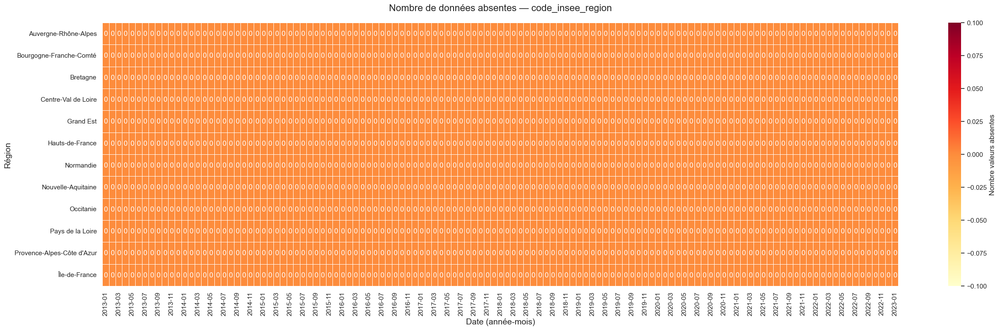

✅ Heatmap sauvegardée : code_in_nan_heatmap.png


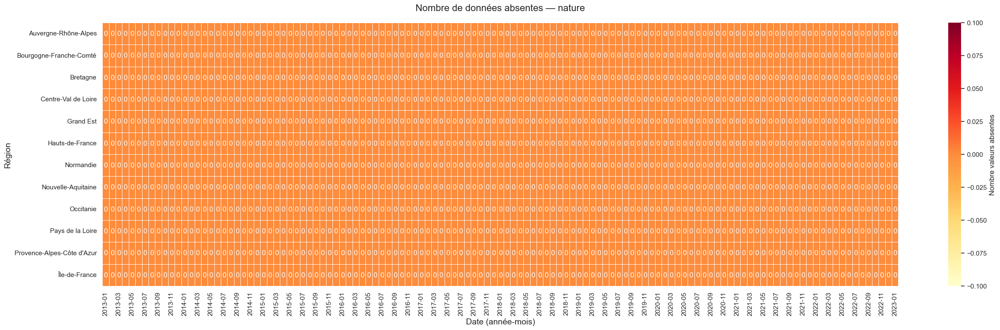

✅ Heatmap sauvegardée : nature_nan_heatmap.png


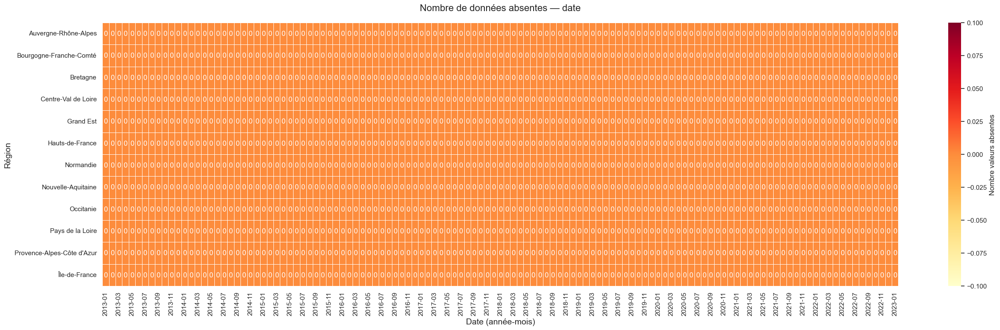

✅ Heatmap sauvegardée : date_nan_heatmap.png


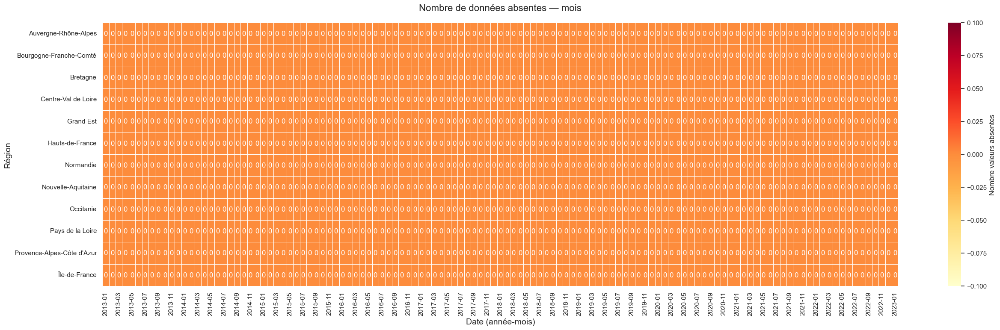

✅ Heatmap sauvegardée : mois_nan_heatmap.png


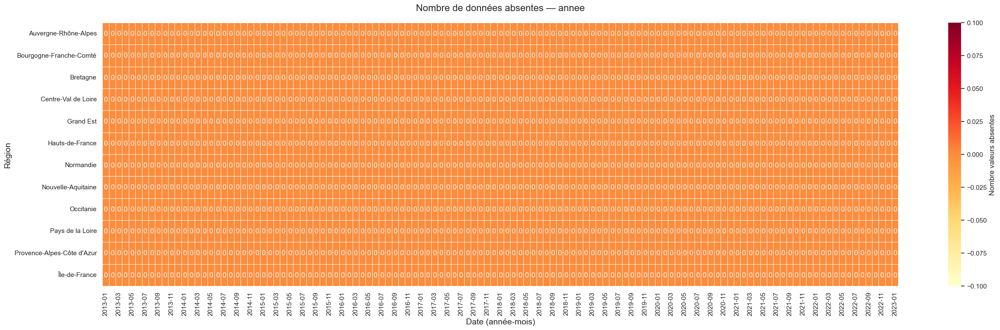

✅ Heatmap sauvegardée : annee_nan_heatmap.png


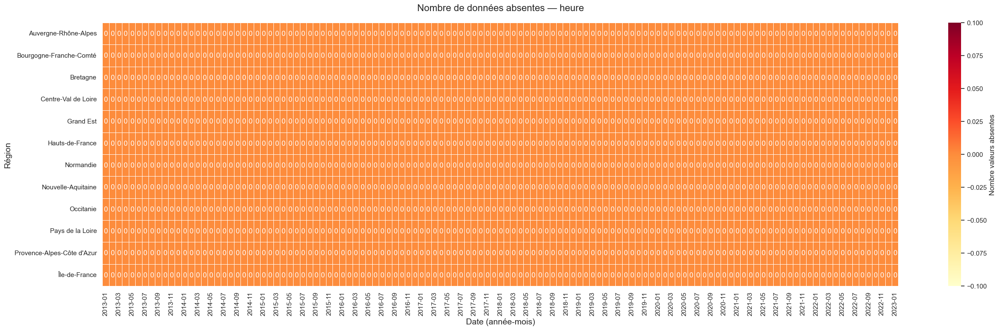

✅ Heatmap sauvegardée : heure_nan_heatmap.png


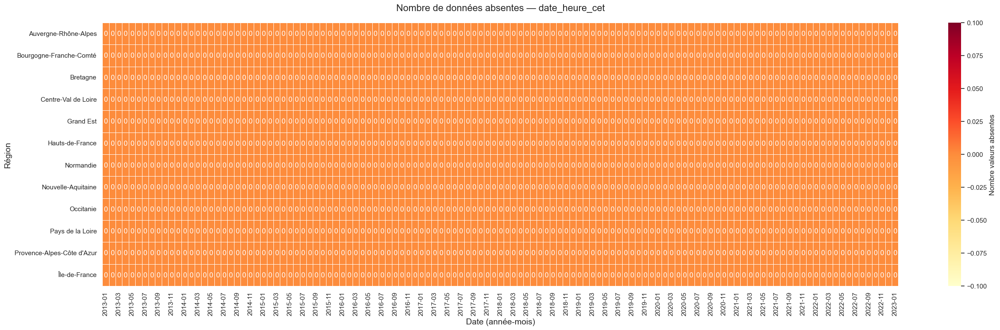

✅ Heatmap sauvegardée : date_he_nan_heatmap.png


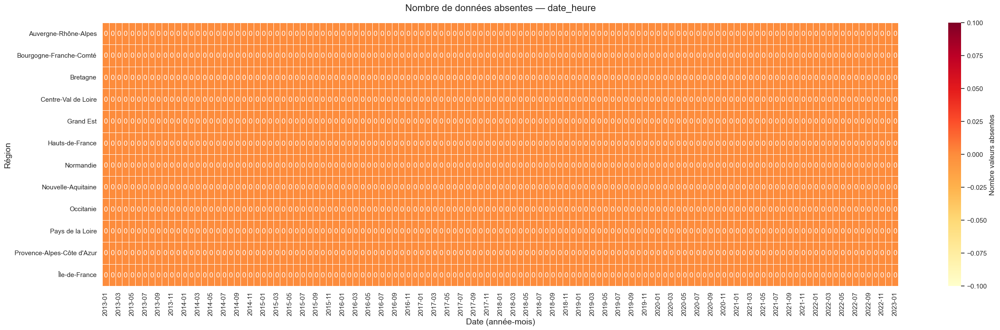

✅ Heatmap sauvegardée : date_he_nan_heatmap.png


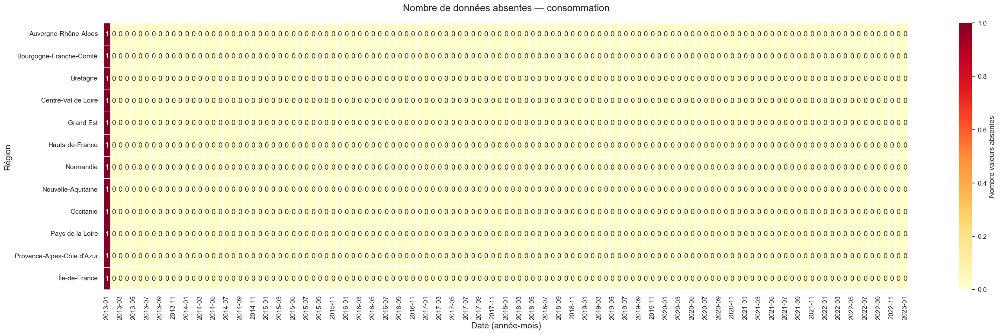

✅ Heatmap sauvegardée : consomm_nan_heatmap.png


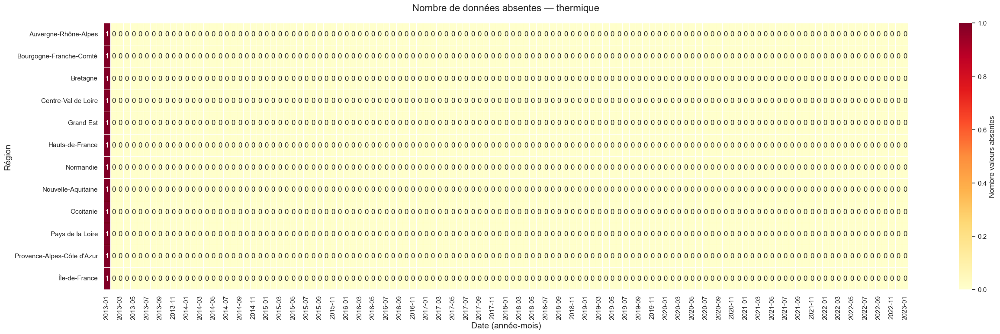

✅ Heatmap sauvegardée : thermiq_nan_heatmap.png


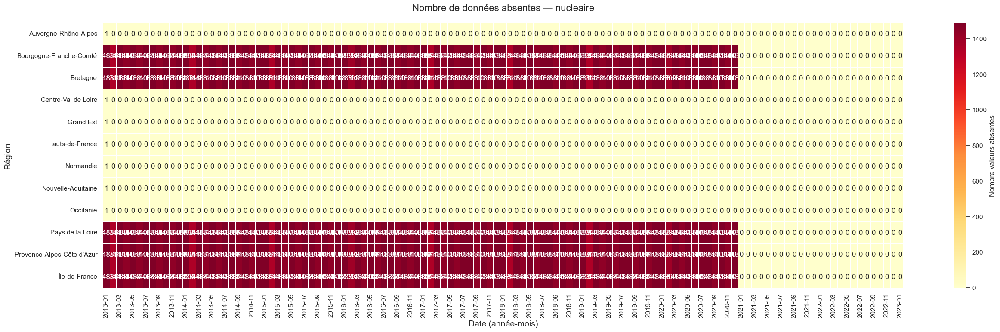

✅ Heatmap sauvegardée : nucleai_nan_heatmap.png


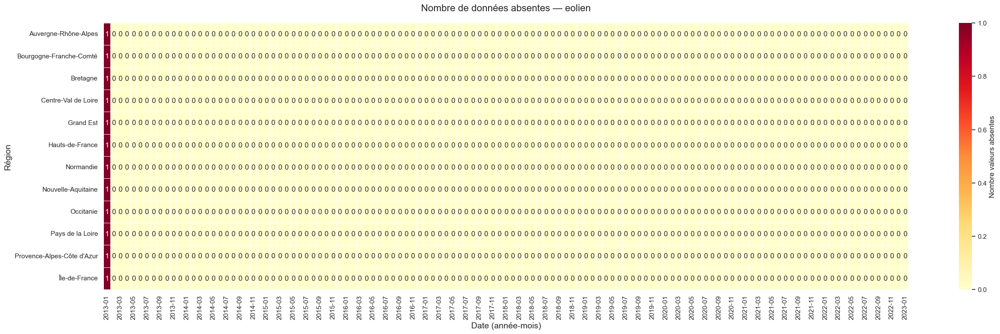

✅ Heatmap sauvegardée : eolien_nan_heatmap.png


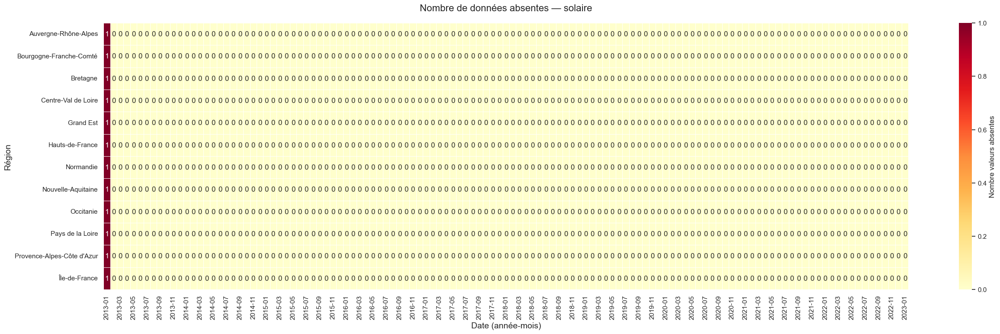

✅ Heatmap sauvegardée : solaire_nan_heatmap.png


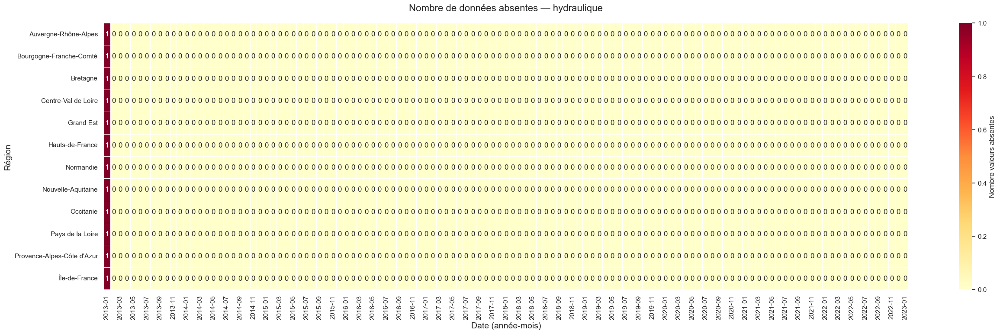

✅ Heatmap sauvegardée : hydraul_nan_heatmap.png


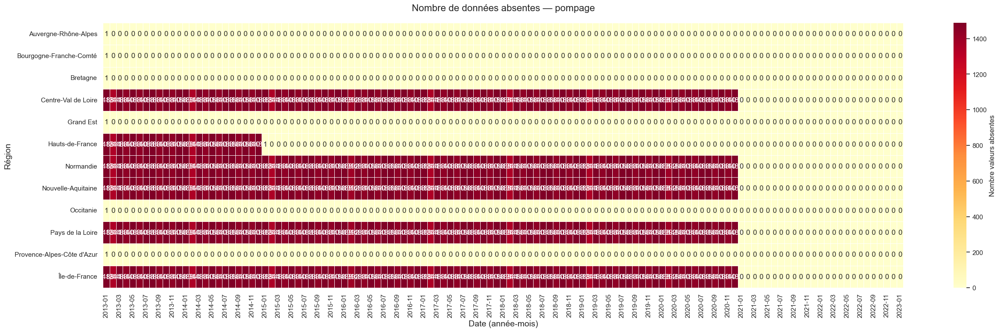

✅ Heatmap sauvegardée : pompage_nan_heatmap.png


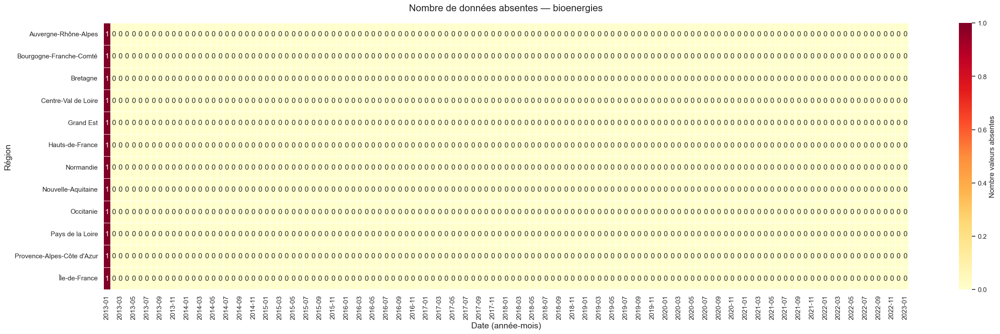

✅ Heatmap sauvegardée : bioener_nan_heatmap.png


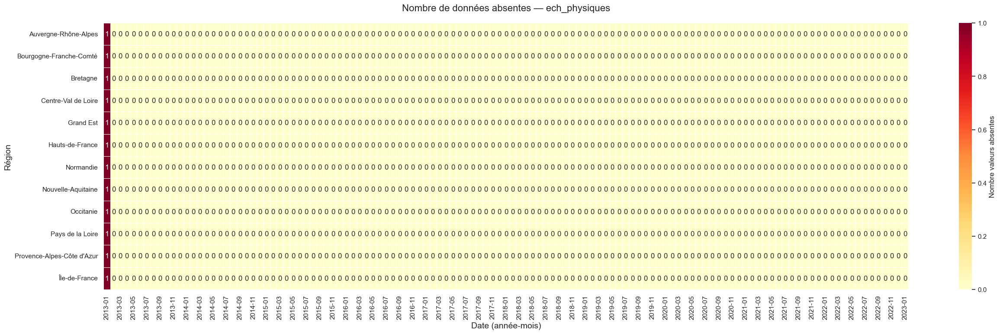

✅ Heatmap sauvegardée : ech_phy_nan_heatmap.png


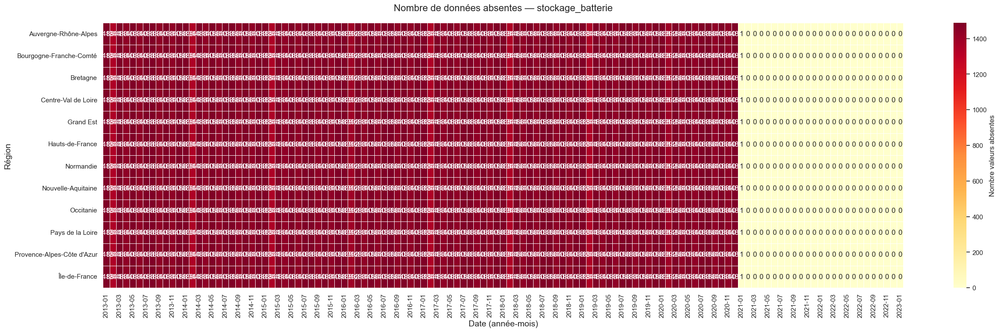

✅ Heatmap sauvegardée : stockag_nan_heatmap.png


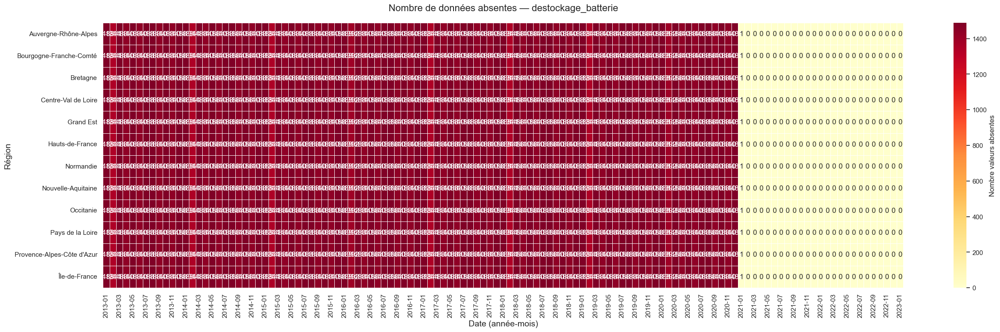

✅ Heatmap sauvegardée : destock_nan_heatmap.png


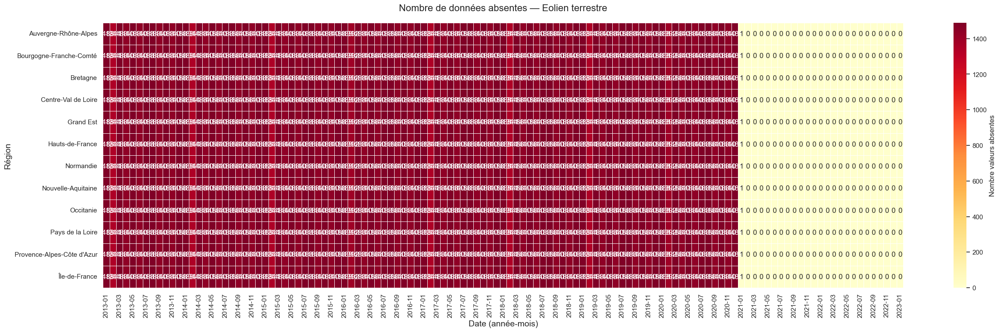

✅ Heatmap sauvegardée : Eolien__nan_heatmap.png


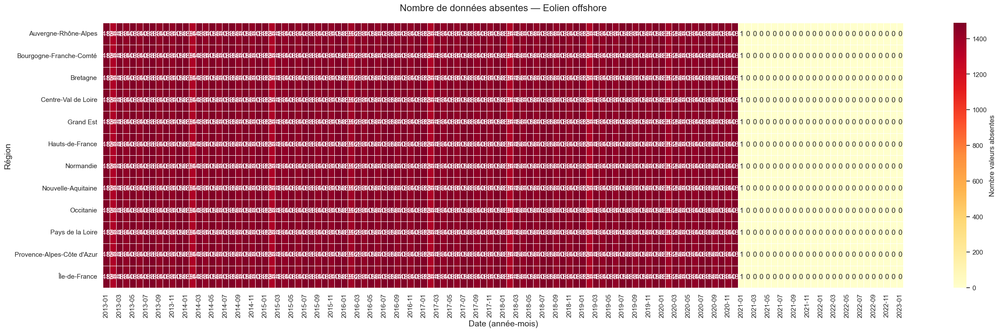

✅ Heatmap sauvegardée : Eolien__nan_heatmap.png


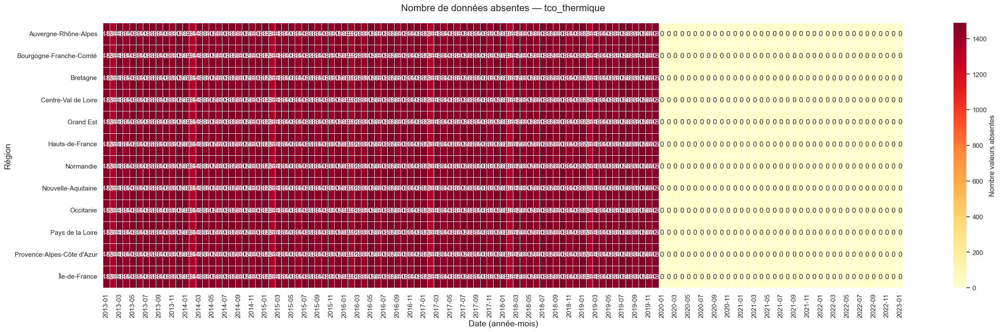

✅ Heatmap sauvegardée : tco_the_nan_heatmap.png


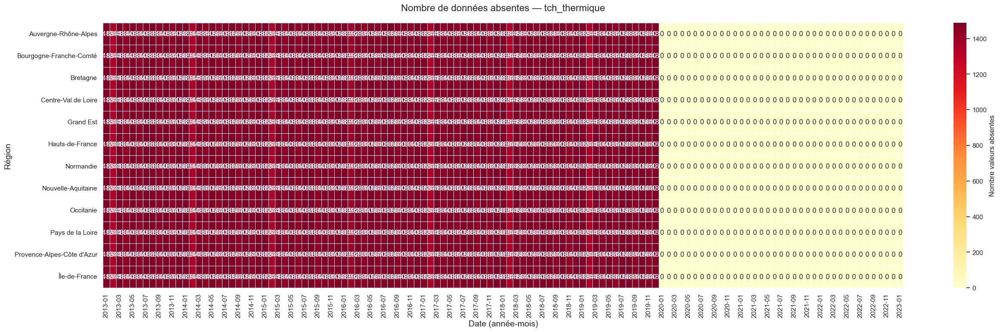

✅ Heatmap sauvegardée : tch_the_nan_heatmap.png


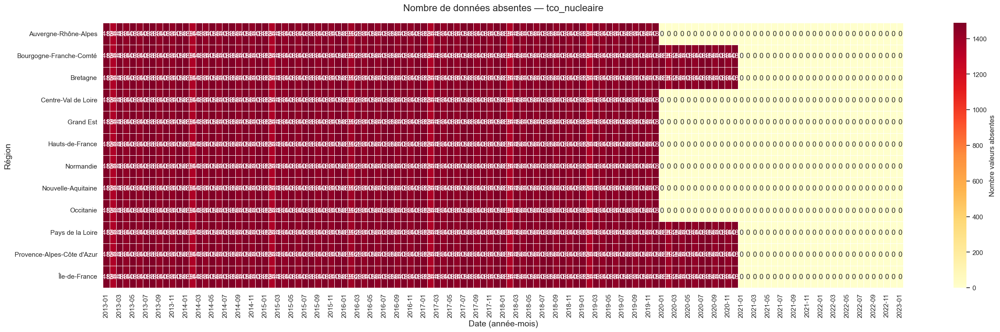

✅ Heatmap sauvegardée : tco_nuc_nan_heatmap.png


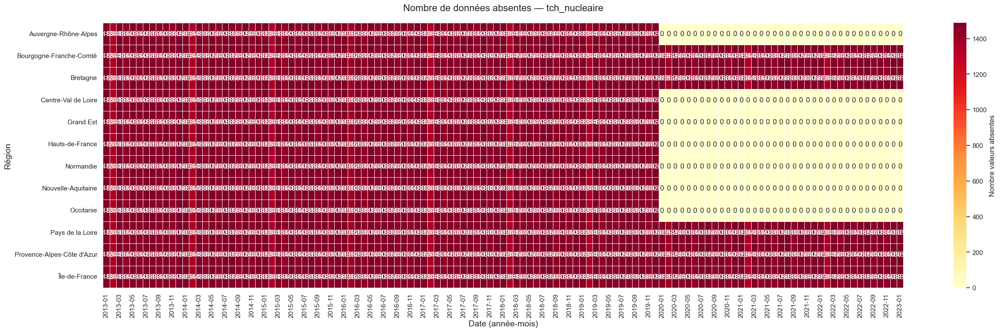

✅ Heatmap sauvegardée : tch_nuc_nan_heatmap.png


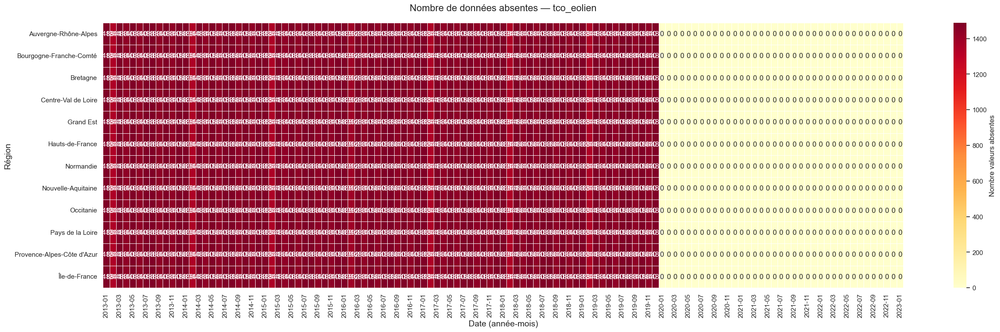

✅ Heatmap sauvegardée : tco_eol_nan_heatmap.png


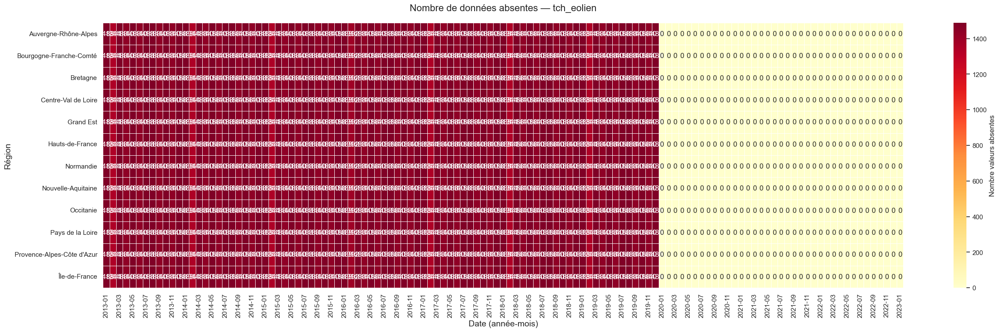

✅ Heatmap sauvegardée : tch_eol_nan_heatmap.png


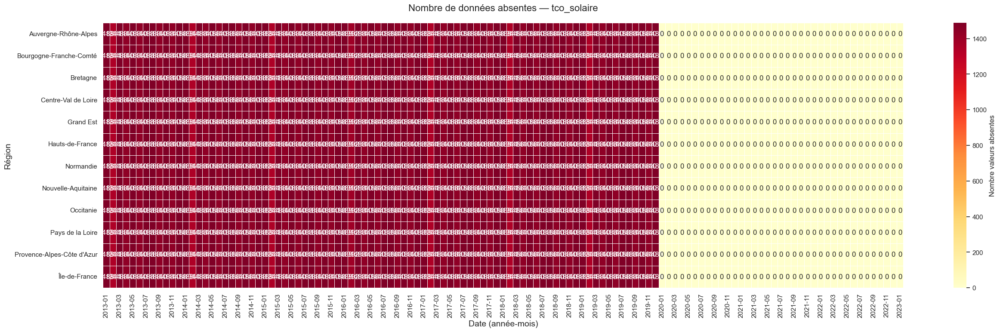

✅ Heatmap sauvegardée : tco_sol_nan_heatmap.png


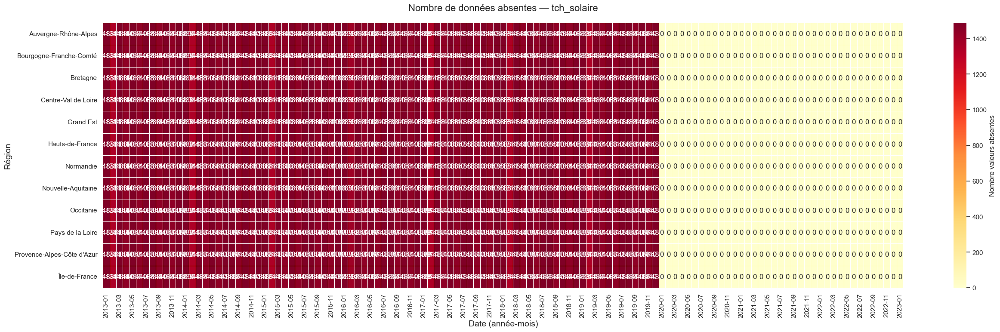

✅ Heatmap sauvegardée : tch_sol_nan_heatmap.png


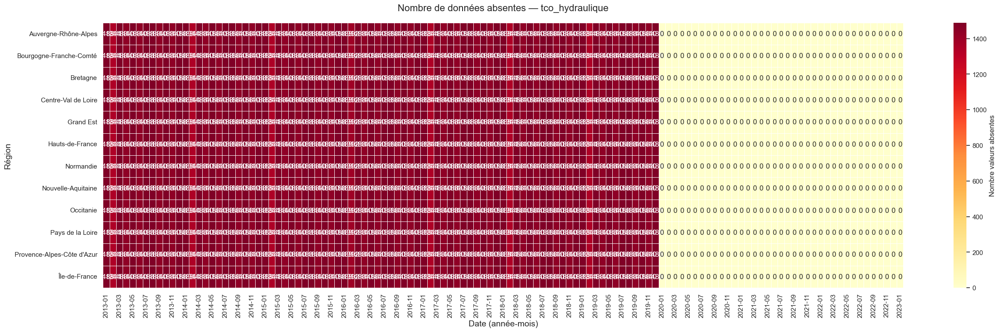

✅ Heatmap sauvegardée : tco_hyd_nan_heatmap.png


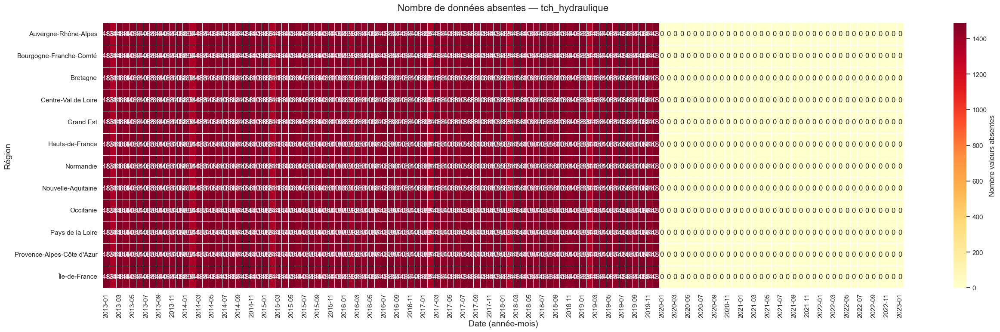

✅ Heatmap sauvegardée : tch_hyd_nan_heatmap.png


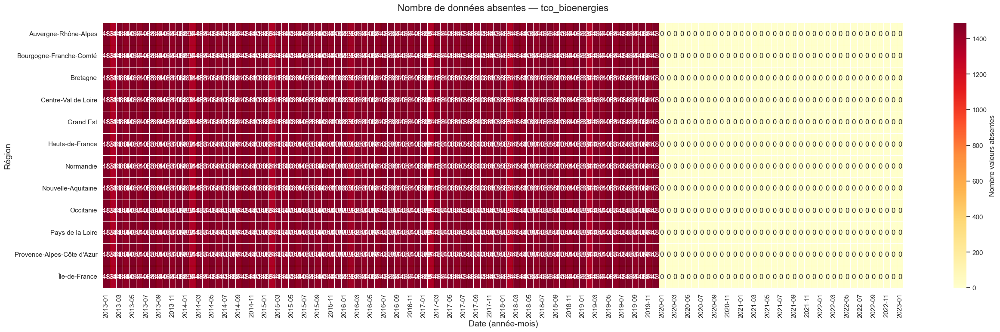

✅ Heatmap sauvegardée : tco_bio_nan_heatmap.png


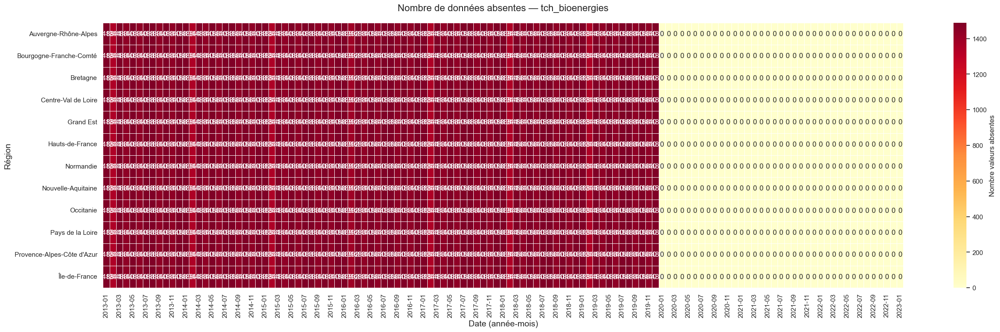

✅ Heatmap sauvegardée : tch_bio_nan_heatmap.png


In [44]:
# Calcul du nombre de valeurs manquantes par région et mois
count_nan = df.groupby(['region', 'date_ym']).agg(lambda x: x.isnull().sum()).reset_index()

# Vérification des colonnes disponibles
print("Colonnes après groupby et reset_index :", count_nan.columns.tolist())

# Filtrage de certaines colonnes spécifiques
# Conserver uniquement 'region', 'date_ym' + colonnes 10 à 34
cols_a_garder = ['region', 'date_ym'] + count_nan.columns[10:35].tolist()
count_nan_filtre = count_nan[cols_a_garder]

#  Export Excel du compte-rendu complet
file_export_count_nan = 'Rapp_count_nan_eco2mix.xlsx'
count_nan.to_excel(file_export_count_nan, index=False)
print(f"✅ Rapport complet exporté : {file_export_count_nan}")

# Export d'une version filtrée
# Les colonnes énergie sont : 'nucleaire', 'thermique', etc.
colonnes_energie = ['region', 'date_ym'] + [col for col in count_nan.columns if 'energie' in col.lower()]
count_nan_filtre = count_nan[colonnes_energie]
file_exp_count_nan_filtre = 'Rapp_count_nan_eco2mix_FILTRE.xlsx'
count_nan_filtre.to_excel(file_exp_count_nan_filtre, index=False)
print(f"✅ Rapport filtré exporté : {file_exp_count_nan_filtre}")

# Préparation du dictionnaire pour les heatmaps
dict_heatmaps_energie_nan = {}
for i in range(2, len(count_nan.columns)):
    nom_colonne = count_nan.columns[i]
    pivot = f'pivot_{nom_colonne[:7]}'
    nom_heatmap = nom_colonne[:7].replace(' ', '_') + '_nan_map'
    nom_fichier = nom_colonne[:7].replace(' ', '_') + '_nan_heatmap.png'
    dict_heatmaps_energie_nan[nom_colonne] = (pivot, nom_heatmap, nom_fichier)

print("🗺️ Dictionnaire des heatmaps prêt :", dict_heatmaps_energie_nan)

# Affichage et export des heatmaps
for nom_colonne in list(dict_heatmaps_energie_nan.keys()):
    pivot, nom_heatmap, nom_fichier = dict_heatmaps_energie_nan[nom_colonne]

    # Création du pivot (région en ligne, mois en colonne)
    pivot_df = count_nan.pivot(index='region', columns='date_ym', values=nom_colonne)

    # Remplacement des NaN par 0
    pivot_df.fillna(0, inplace=True)

    # Affichage
    plt.figure(figsize=(30, 8))
    heatmap = sns.heatmap(pivot_df, cmap='YlOrRd', annot=True, fmt='.0f',
                          cbar_kws={'label': 'Nombre valeurs absentes'},
                          linewidths=0.5, vmin=0)

    plt.title(f"Nombre de données absentes — {nom_colonne}", fontsize=16, pad=20)
    plt.xlabel('Date (année-mois)', fontsize=14)
    plt.ylabel('Région', fontsize=14)

    # Sauvegarde
    heatmap.figure.savefig(nom_fichier, bbox_inches='tight', dpi=300)
    plt.show()

    print(f"✅ Heatmap sauvegardée : {nom_fichier}")


Rapport préliminaire de décompte des valeurs égales à 0 après regroupements exporté avec succès dans le fichier Excel 'Rapp_count_zeros_eco2mix.xlsx'
Rapport préliminaire de décompte des valeurs égales à 0 filtré exporté avec succès dans le fichier Excel 'Rapp_count_zeros_eco2mix_FILTRE.xlsx'


{'date_heure': ('pivot_date_he',
  'date_heurzeros_map',
  '7_date_heur_zeros_heatmap.png'),
 'consommation': ('pivot_consomm',
  'consommatzeros_map',
  '8_consommat_zeros_heatmap.png'),
 'thermique': ('pivot_thermiq',
  'thermiquezeros_map',
  '9_thermique_zeros_heatmap.png'),
 'nucleaire': ('pivot_nucleai',
  'nucleairezeros_map',
  '10_nucleaire_zeros_heatmap.png'),
 'eolien': ('pivot_eolien', 'eolienzeros_map', '11_eolien_zeros_heatmap.png'),
 'solaire': ('pivot_solaire',
  'solairezeros_map',
  '12_solaire_zeros_heatmap.png'),
 'hydraulique': ('pivot_hydraul',
  'hydrauliqzeros_map',
  '13_hydrauliq_zeros_heatmap.png'),
 'pompage': ('pivot_pompage',
  'pompagezeros_map',
  '14_pompage_zeros_heatmap.png'),
 'bioenergies': ('pivot_bioener',
  'bioenergizeros_map',
  '15_bioenergi_zeros_heatmap.png'),
 'ech_physiques': ('pivot_ech_phy',
  'ech_physizeros_map',
  '16_ech_physi_zeros_heatmap.png'),
 'stockage_batterie': ('pivot_stockag',
  'stockage_zeros_map',
  '17_stockage__zeros_h

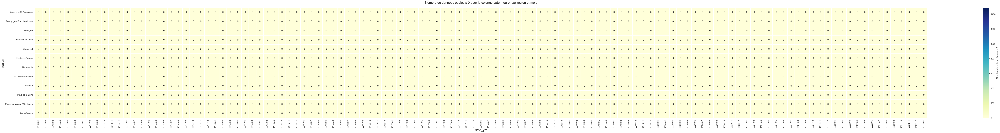

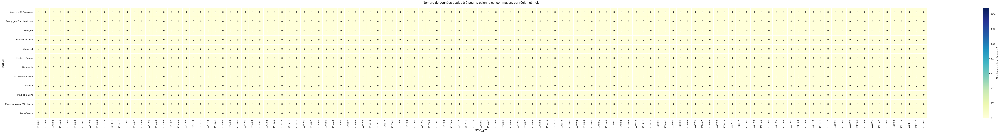

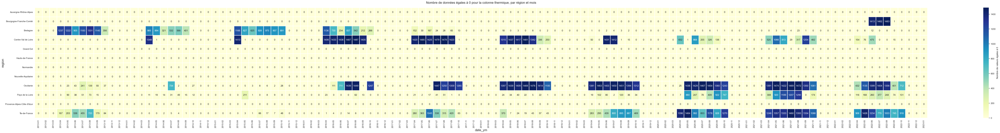

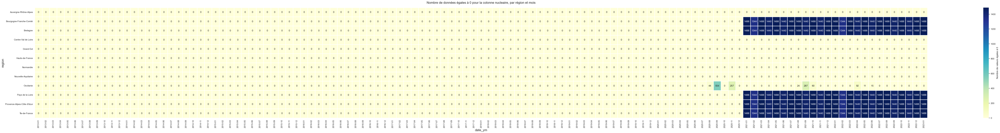

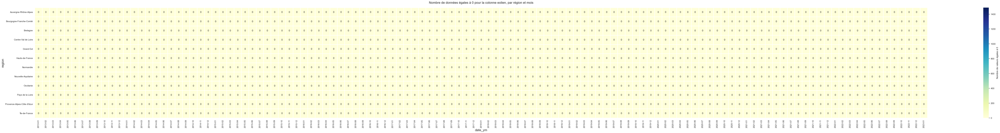

...

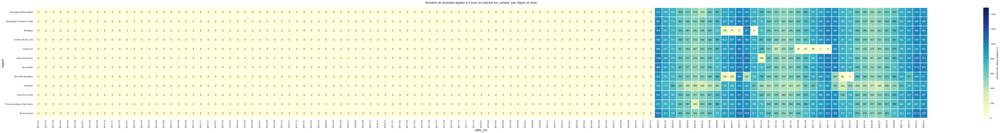

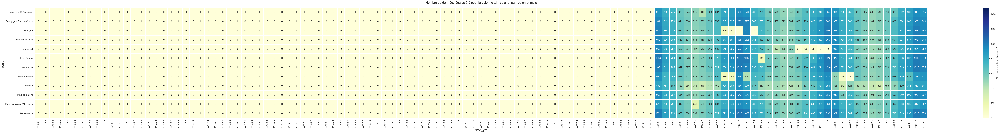

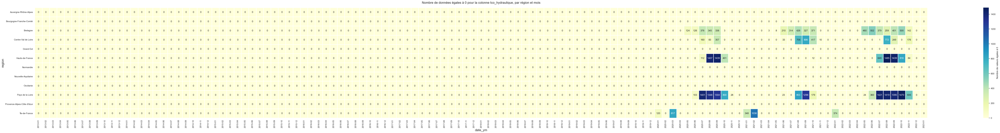

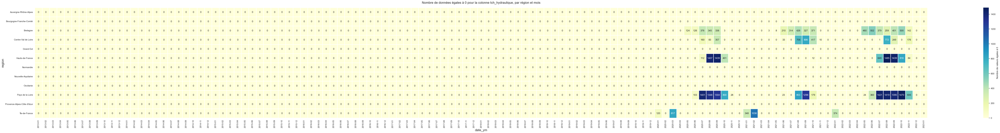

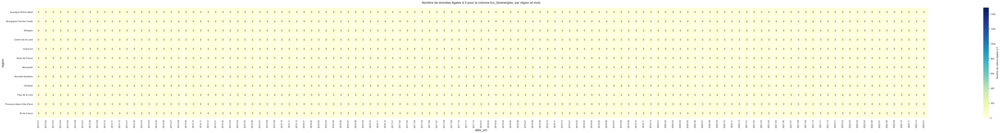

In [45]:
#  ******  ETUDE DES VALEURS EGALES A ZERO (0) ******

# Calcul du nombre de valeurs égales à 0 pour chaque colonne, par région et par mois.

count_zeros = df.groupby([df['region'], df['date_ym']]).apply(lambda x: (x==0).sum())

# Suppression des colonnes superflues de count_zeros

count_zeros = count_zeros.drop(count_zeros.columns[0:9], axis=1)

# Réinitialisation de l'index

count_zeros = count_zeros.reset_index()

# Export Excel du compte-rendu du nb de valeurs égales à 0 par colonne après regroupement Région/Jour-Mois

file_export_count_zeros ='Rapp_count_zeros_eco2mix.xlsx'
count_zeros.to_excel(file_export_count_zeros)
print("Rapport préliminaire de décompte des valeurs égales à 0 après regroupements exporté avec succès dans le fichier Excel 'Rapp_count_zeros_eco2mix.xlsx'")

# Export Excel du compte-rendu du nb de valeurs égales à 0 filtré

file_exp_count_zeros_filtre ='Rapp_count_zeros_eco2mix_FILTRE.xlsx'

count_zeros.to_excel(file_exp_count_zeros_filtre)

print("Rapport préliminaire de décompte des valeurs égales à 0 filtré exporté avec succès dans le fichier Excel 'Rapp_count_zeros_eco2mix_FILTRE.xlsx'")

# AFFICHAGE DES HEATMAPS DES VALEURS EGALES A 0, REGROUPEES PAR REGION ET PAR MOIS

# 1) Création d'un dictionnaire associant les colonnes mappées avec les noms des graphiques et des fichiers images à créer

dict_heatmaps_energie_zeros = {}
colonnes=['7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','23','24','25','26','27','28','29','30','31']
c=0
for i in range(2, 27):
    nom_colonne = count_zeros.columns[i]
    pivot = 'pivot_'+ nom_colonne[:7]
    nom_heatmap = nom_colonne[:9].replace(' ', '_') + 'zeros_map'
    nom_fichier = colonnes[c] +'_'+ nom_colonne[:9].replace(' ', '_') + '_zeros_heatmap.png'
    dict_heatmaps_energie_zeros[nom_colonne] = (pivot, nom_heatmap, nom_fichier)
    c+=1

display(dict_heatmaps_energie_zeros)

# 2) Affichage des chronogramme des valeurs égales à 0 pour chaque colonne de données d'énergie

for i in range(2,27):
    
    nom_colonne = count_zeros.columns[i]
    pivot, nom_heatmap, nom_fichier = dict_heatmaps_energie_zeros[nom_colonne]
                                                       
    # Pivot du DataFrame pour obtenir les dates comme colonnes
 
    pivot_df = count_zeros.pivot(index='region', columns='date_ym', values=nom_colonne)
    
    # Création d'un heatmap
    
    plt.figure(figsize=(100, 10))
    nom_heatmap = sns.heatmap(pivot_df, cmap='YlGnBu', annot=True, fmt='d', cbar_kws={'label': 'Nombre de valeurs égales à 0'},
                                 linewidths = 1, vmin = 0, vmax = 1488)
    plt.title(f"Nombre de données égales à 0 pour la colonne {nom_colonne}, par région et mois", fontsize = 16, pad = 20)
    plt.xlabel('date_ym', fontsize = 16)
    plt.ylabel('region', fontsize = 16)
    plt.show()

    nom_heatmap.figure.savefig(nom_fichier)


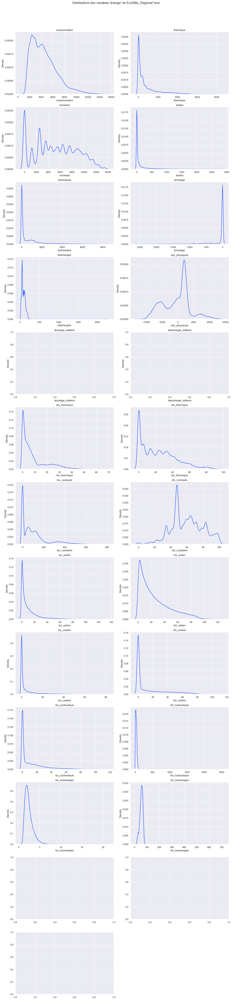

In [46]:
# Filtrage des colonnes numériques
selected_columns = [
    'consommation', 'thermique', 'nucleaire', 'eolien', 'solaire',
    'hydraulique', 'pompage', 'bioenergies', 'ech_physiques',
    'stockage_batterie', 'destockage_batterie',
    'tco_thermique', 'tch_thermique', 'tco_nucleaire', 'tch_nucleaire',
    'tco_eolien', 'tch_eolien', 'tco_solaire', 'tch_solaire',
    'tco_hydraulique', 'tch_hydraulique', 'tco_bioenergies', 'tch_bioenergies'
]
selected_columns_numeric = df[selected_columns].select_dtypes(include=['number']).columns

fig, axs = plt.subplots(13, 2, figsize=(15, 65))

# Aplatissement de l'array d'axes pour faciliter son utilisation
axs = axs.flatten()

plt.suptitle("Distributions des variables 'énergie' de Eco2Mix_Regional' brut")
# Création d'un histogramme pour chaque colonne numérique
for ax, col in zip(axs, selected_columns_numeric):
    sns.kdeplot(df[col], ax=ax)
    ax.set_title(col)

# Suppression de la zone de graphique inutilsée
fig.delaxes(axs[-1])

# Ajustement de l'espacement entre les sous-tracés
plt.tight_layout()
plt.subplots_adjust(top=0.95)

# Sauvegarde de la figure en haute résolution
plt.savefig('Histogrammes_données_brutes.png', dpi=300)

# Affichage de la figure
plt.show()

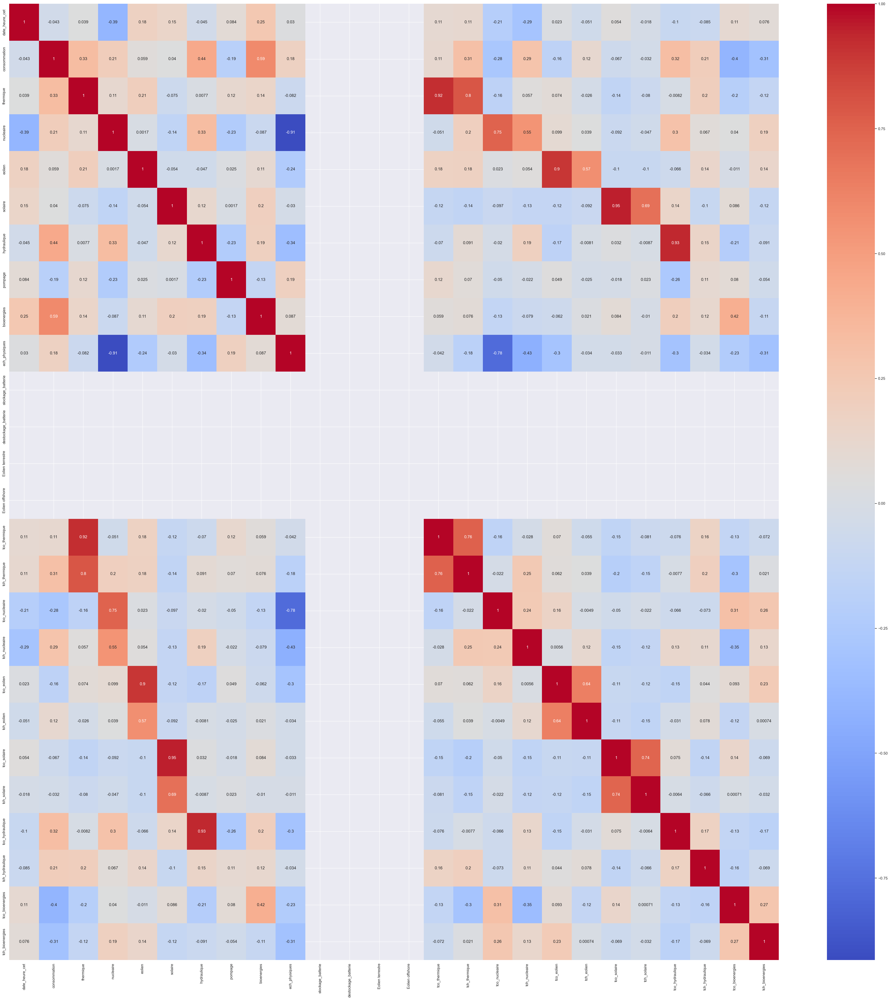

In [47]:
# Affichage d'un heatmap des corrélations du fichier Eco2Mix Regional brut
colonnes_to_drop = ['code_insee_region', 'region', 'nature','date', 'mois','annee', 'date_ym','heure','date_heure']
df_reduce = df.drop(columns=colonnes_to_drop, axis = 1)

# Remplacement des chaînes '-' par NaN
df_reduce = df_reduce.replace('-', np.nan)

# Conversion en numérique forcée
df_reduce = df_reduce.apply(pd.to_numeric, errors='coerce')

cor = df_reduce.corr()
fig, axs = plt.subplots(figsize = (50,50))
savefighcor = sns.heatmap(cor, annot = True, ax = axs, cmap = "coolwarm")
plt.show()

# Exportation des graphiques dans des fichiers
savefighcor.figure.savefig('Heatmaps_corrélations_Eco2MixReg.png')